<a href="https://colab.research.google.com/github/cabrera21hub/colab_Proyect/blob/main/Arturo_calodad_aire.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Mostrar las primeras filas del archivo
data_2023.head()


,fecha,CO,NO,NO2,NOX,O3,PM10,PM25,SO2
0,2015-01-01,1.050696,22.765528,24.225155,46.987578,23.175150,105.573684,78.953405,11.554723
1,2015-01-02,0.807585,32.249608,21.554160,53.800628,17.268366,36.687845,15.449438,1.895052
2,2015-01-03,0.640755,21.686916,19.394081,41.071651,15.486486,29.269022,12.915129,1.436937
3,2015-01-04,0.726940,24.606272,19.560976,44.165505,17.329032,39.961538,16.838284,1.809061
4,2015-01-05,0.530815,11.443182,20.990260,32.439935,14.470588,31.855643,12.667774,8.315789


In [2]:
pip install meteostat


In [3]:
from meteostat import Point, Daily
from datetime import datetime

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2022, 1, 1)
end = datetime(2023, 5, 31)

# Obtener los datos diarios
weather_data = Daily(location, start, end)
weather_data = weather_data.fetch()

# Mostrar las primeras filas de los datos meteorológicos
weather_data.head()


,tavg,tmin,tmax,prcp,snow,wdir,wspd,wpgt,pres,tsun
time,,,,,,,,,,
2022-01-01,16.3,8.0,24.0,0.0,NaN,60.0,7.8,NaN,1023.0,NaN
2022-01-02,15.0,8.0,24.0,0.0,NaN,11.0,11.5,NaN,1025.0,NaN
2022-01-03,13.8,8.0,21.0,0.0,NaN,45.0,9.6,NaN,1029.8,NaN
2022-01-04,15.7,8.0,24.0,0.0,NaN,95.0,7.8,NaN,1027.3,NaN
2022-01-05,16.6,8.0,25.0,0.0,NaN,101.0,8.5,NaN,1024.2,NaN


In [5]:
import pandas as pd
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Mostrar las primeras filas del archivo
print(data_2023.head())

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2022, 1, 1)
end = datetime(2023, 5, 31)

# Obtener los datos diarios
weather_data = Daily(location, start, end)
weather_data = weather_data.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Unir los datos por la columna de fecha
merged_data = pd.merge(data_2023, weather_data, left_on='fecha', right_on='time')

# Mostrar las primeras filas de los datos fusionados
print(merged_data.head())


        fecha        CO         NO        NO2        NOX         O3  \
0  2015-01-01  1.050696  22.765528  24.225155  46.987578  23.175150   
1  2015-01-02  0.807585  32.249608  21.554160  53.800628  17.268366   
2  2015-01-03  0.640755  21.686916  19.394081  41.071651  15.486486   
3  2015-01-04  0.726940  24.606272  19.560976  44.165505  17.329032   
4  2015-01-05  0.530815  11.443182  20.990260  32.439935  14.470588   

         PM10       PM25        SO2  
0  105.573684  78.953405  11.554723  
1   36.687845  15.449438   1.895052  
2   29.269022  12.915129   1.436937  
3   39.961538  16.838284   1.809061  
4   31.855643  12.667774   8.315789  
       fecha        CO         NO        NO2        NOX         O3       PM10  \
0 2022-01-01  0.834530  15.479339  27.756897  44.221074  33.478571  89.435449   
1 2022-01-02  0.466672  17.148148  19.517182  36.726337  20.493599  60.549145   
2 2022-01-03  0.474306   9.838624  28.136054  37.894180  27.146825  59.957778   
3 2022-01-04  0.78505

In [10]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import joblib
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2022, 1, 1)
end = datetime(2023, 5, 31)

# Obtener los datos diarios
weather_data = Daily(location, start, end)
weather_data = weather_data.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Unir los datos por la columna de fecha
merged_data = pd.merge(data_2023, weather_data, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_renamed = merged_data.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_renamed = merged_data_renamed.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X) y variable objetivo (y)
X = merged_data_renamed[['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2',
                         'average_temperature', 'minimum_temperature', 'maximum_temperature',
                         'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
y = merged_data_renamed['PM25']  # Ejemplo, prediciendo PM25. Ajusta según tu objetivo.

# División de los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entrenamiento del modelo
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predicción y evaluación del modelo
y_pred = model.predict(X_test)
rmse = mean_squared_error(y_test, y_pred, squared=False)
print(f'RMSE: {rmse}')

# Guardar el modelo entrenado
joblib.dump(model, 'modelo_calidad_aire.pkl')


RMSE: 1.3552410019904568


['modelo_calidad_aire.pkl']

In [11]:
pip install xgboost lightgbm scikit-learn tensorflow


In [12]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import lightgbm as lgb
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import joblib
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2022, 1, 1)
end = datetime(2023, 5, 31)

# Obtener los datos diarios
weather_data = Daily(location, start, end)
weather_data = weather_data.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Unir los datos por la columna de fecha
merged_data = pd.merge(data_2023, weather_data, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_renamed = merged_data.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_renamed = merged_data_renamed.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X) y variable objetivo (y)
X = merged_data_renamed[['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2',
                         'average_temperature', 'minimum_temperature', 'maximum_temperature',
                         'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
y = merged_data_renamed['PM25']  # Ejemplo, prediciendo PM25. Ajusta según tu objetivo.

# División de los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Diccionario para almacenar los resultados de los modelos
results = {}

# Función para entrenar y evaluar un modelo
def evaluate_model(model, model_name):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    results[model_name] = rmse
    print(f'{model_name} RMSE: {rmse}')

# RandomForestRegressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
evaluate_model(rf_model, 'RandomForestRegressor')

# GradientBoostingRegressor
gb_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
evaluate_model(gb_model, 'GradientBoostingRegressor')

# Support Vector Regression
svr_model = SVR()
evaluate_model(svr_model, 'SVR')

# XGBoost
xgb_model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
evaluate_model(xgb_model, 'XGBoost')

# LightGBM
lgb_model = lgb.LGBMRegressor(n_estimators=100, random_state=42)
evaluate_model(lgb_model, 'LightGBM')

# Neural Network
nn_model = Sequential()
nn_model.add(Dense(64, input_dim=X_train.shape[1], activation='relu'))
nn_model.add(Dense(32, activation='relu'))
nn_model.add(Dense(1))
nn_model.compile(optimizer='adam', loss='mean_squared_error')

nn_model.fit(X_train, y_train, epochs=50, batch_size=10, verbose=0)
y_pred_nn = nn_model.predict(X_test)
rmse_nn = mean_squared_error(y_test, y_pred_nn, squared=False)
results['NeuralNetwork'] = rmse_nn
print(f'NeuralNetwork RMSE: {rmse_nn}')

# Imprimir los resultados de todos los modelos
print("\nComparación de Modelos:")
for model_name, rmse in results.items():
    print(f'{model_name}: {rmse}')


RandomForestRegressor RMSE: 1.3552410019904568
GradientBoostingRegressor RMSE: 1.301558029349076
SVR RMSE: 7.646762687016883
XGBoost RMSE: 1.0495880642639754
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000781 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1507
[LightGBM] [Info] Number of data points in the train set: 412, number of used features: 15
[LightGBM] [Info] Start training from score 19.902072
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

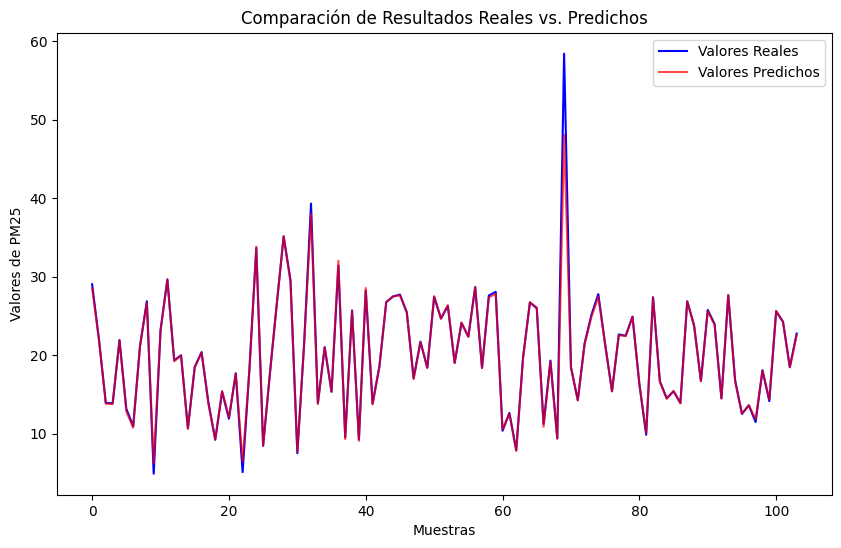

In [13]:
import matplotlib.pyplot as plt
import numpy as np

# Realizar las predicciones con el modelo XGBoost entrenado
y_pred = xgb_model.predict(X_test)

# Graficar los resultados reales vs. predichos
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Valores Reales', color='blue')
plt.plot(y_pred, label='Valores Predichos', color='red', alpha=0.7)
plt.title('Comparación de Resultados Reales vs. Predichos')
plt.xlabel('Muestras')
plt.ylabel('Valores de PM25')
plt.legend()
plt.show()


CO RMSE: 0.09186829895448073
NO RMSE: 5.112339725072541
NO2 RMSE: 3.9510193385091017
NOX RMSE: 8.147208565160952
O3 RMSE: 6.603689791447911
PM10 RMSE: 10.236978366171483
PM25 RMSE: 6.353337642690342
SO2 RMSE: 1.4710941689488688


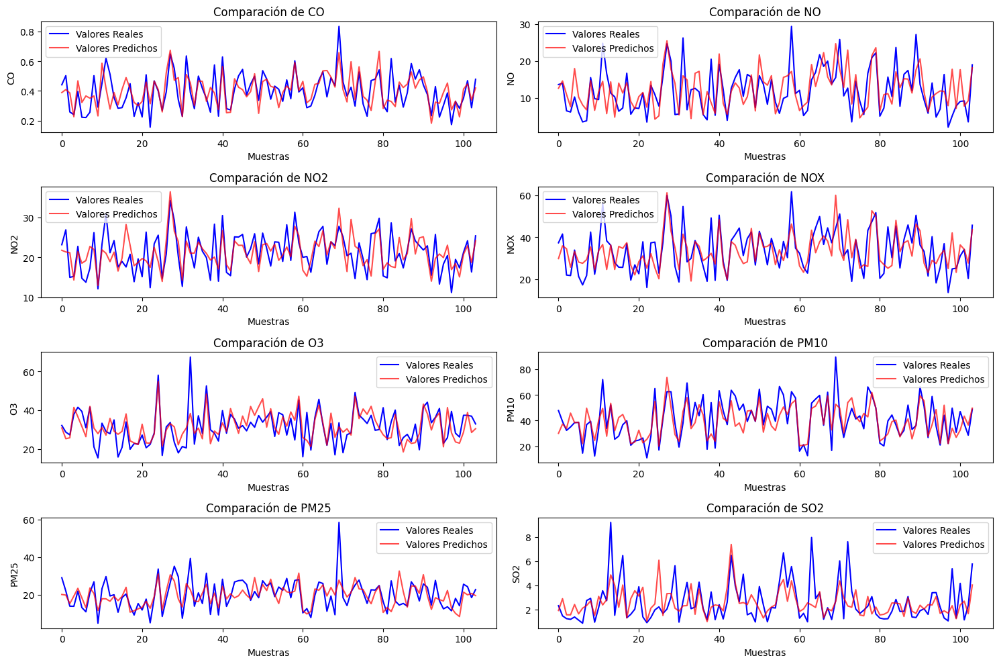

In [14]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2022, 1, 1)
end = datetime(2023, 5, 31)

# Obtener los datos diarios
weather_data = Daily(location, start, end)
weather_data = weather_data.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Unir los datos por la columna de fecha
merged_data = pd.merge(data_2023, weather_data, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_renamed = merged_data.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_renamed = merged_data_renamed.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X = merged_data_renamed[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                         'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Entrenar un modelo para cada variable objetivo y almacenar las predicciones
for target in target_variables:
    y = merged_data_renamed[target]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    predictions[target] = (y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE: {rmse}')

# Graficar los resultados reales vs. predichos para cada variable
plt.figure(figsize=(15, 10))
for i, target in enumerate(target_variables):
    y_test, y_pred = predictions[target]
    plt.subplot(4, 2, i+1)
    plt.plot(y_test.values, label='Valores Reales', color='blue')
    plt.plot(y_pred, label='Valores Predichos', color='red', alpha=0.7)
    plt.title(f'Comparación de {target}')
    plt.xlabel('Muestras')
    plt.ylabel(target)
    plt.legend()

plt.tight_layout()
plt.show()


CO RMSE: 0.09186829895448073
NO RMSE: 5.112339725072541
NO2 RMSE: 3.9510193385091017
NOX RMSE: 8.147208565160952
O3 RMSE: 6.603689791447911
PM10 RMSE: 10.236978366171483
PM25 RMSE: 6.353337642690342
SO2 RMSE: 1.4710941689488688


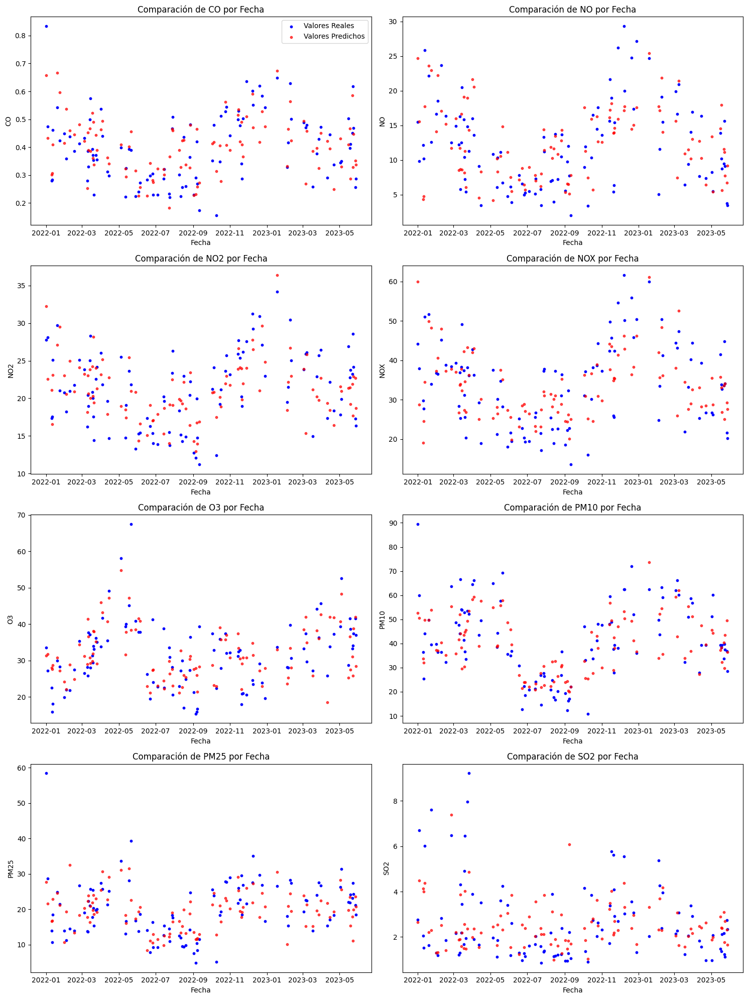

In [19]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2022, 1, 1)
end = datetime(2023, 5, 31)

# Obtener los datos diarios
weather_data = Daily(location, start, end)
weather_data = weather_data.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Unir los datos por la columna de fecha
merged_data = pd.merge(data_2023, weather_data, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_renamed = merged_data.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_renamed = merged_data_renamed.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X = merged_data_renamed[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                         'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Entrenar un modelo para cada variable objetivo y almacenar las predicciones
for target in target_variables:
    y = merged_data_renamed[target]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    predictions[target] = (X_test.index, y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE: {rmse}')

# Graficar los resultados reales vs. predichos para cada variable
plt.figure(figsize=(15, 20))
for i, target in enumerate(target_variables):
    indices, y_test, y_pred = predictions[target]
    dates = merged_data_renamed.loc[indices]['fecha']
    plt.subplot(4, 2, i+1)
    plt.scatter(dates, y_test.values, label='Valores Reales', color='blue', s=10)
    plt.scatter(dates, y_pred, label='Valores Predichos', color='red', alpha=0.7, s=10)
    plt.title(f'Comparación de {target} por Fecha')
    plt.xlabel('Fecha')
    plt.ylabel(target)
    if i == 0:
        plt.legend()

plt.tight_layout()
plt.show()


CO RMSE: 0.08465086495950915
NO RMSE: 5.7731503362722805
NO2 RMSE: 3.764595640023717
NOX RMSE: 8.99440194732794
O3 RMSE: 5.614482693785263
PM10 RMSE: 10.151771621462577
PM25 RMSE: 6.022004590117567
SO2 RMSE: 1.3971562835822842


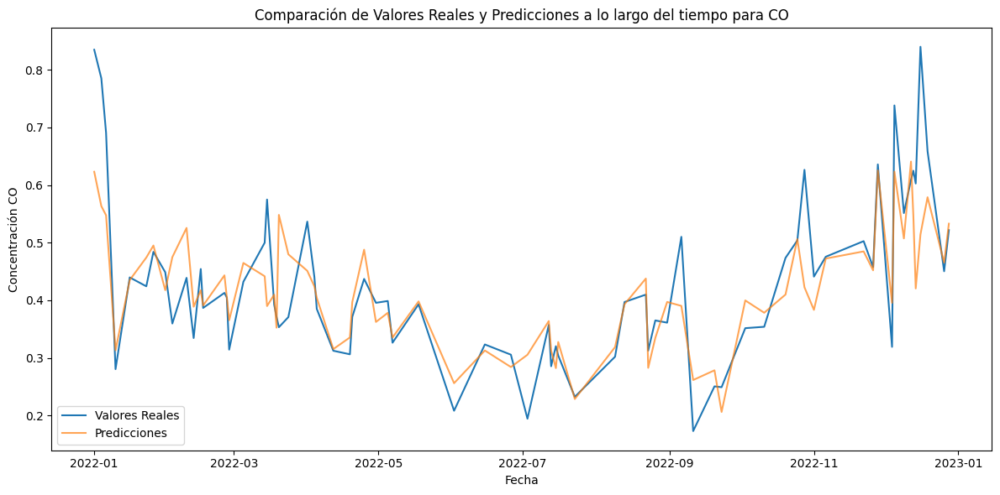

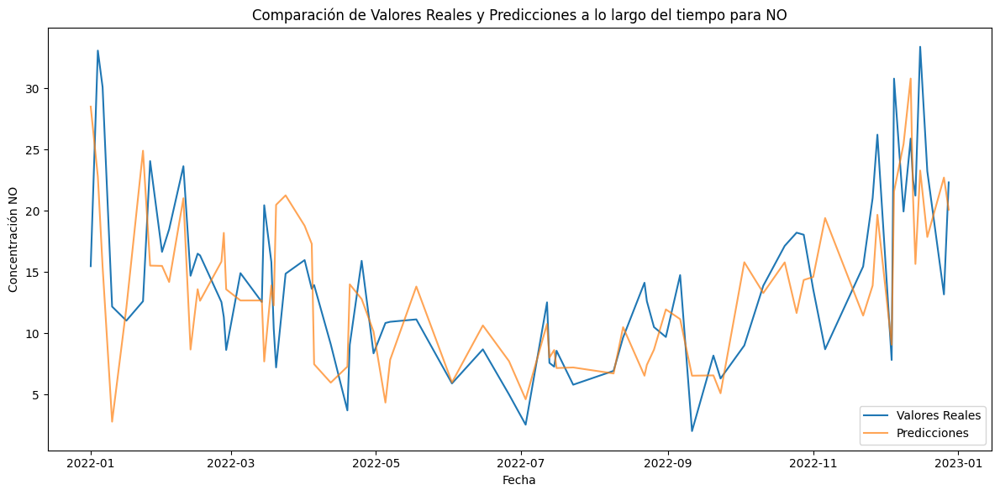

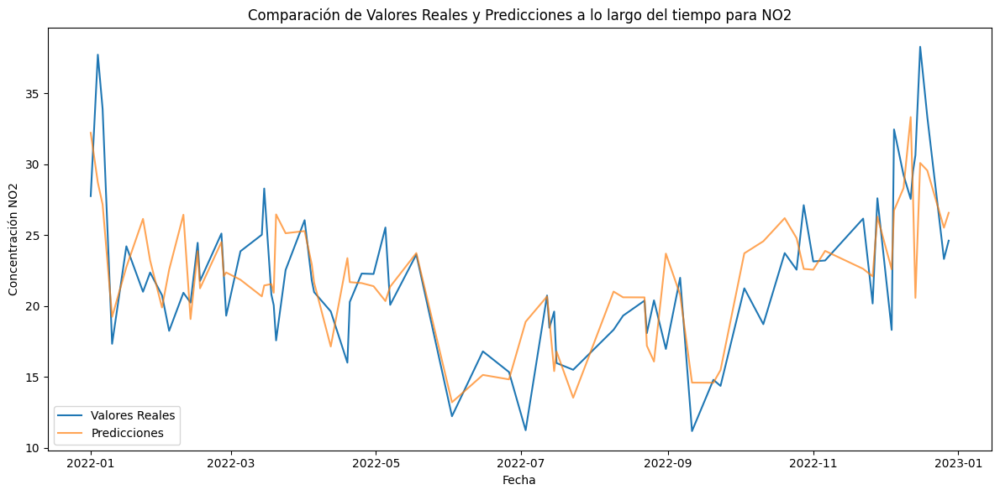

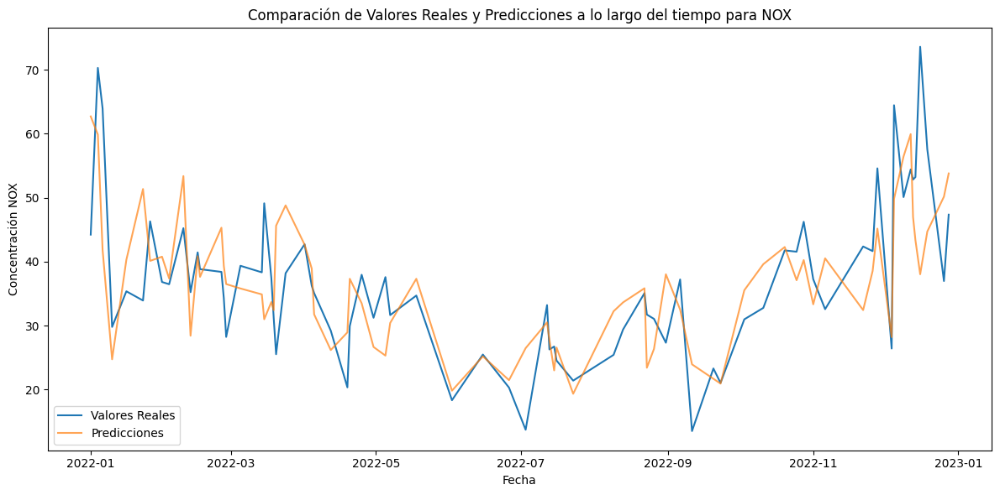

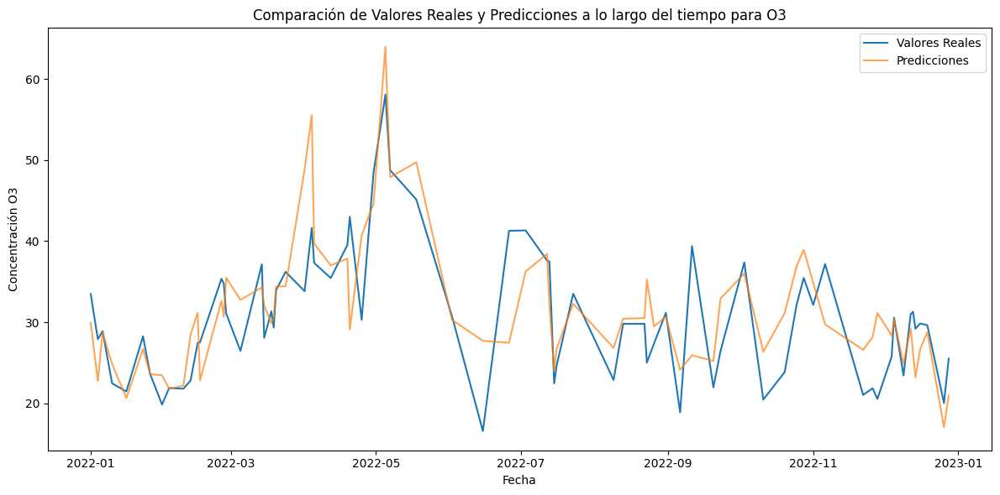

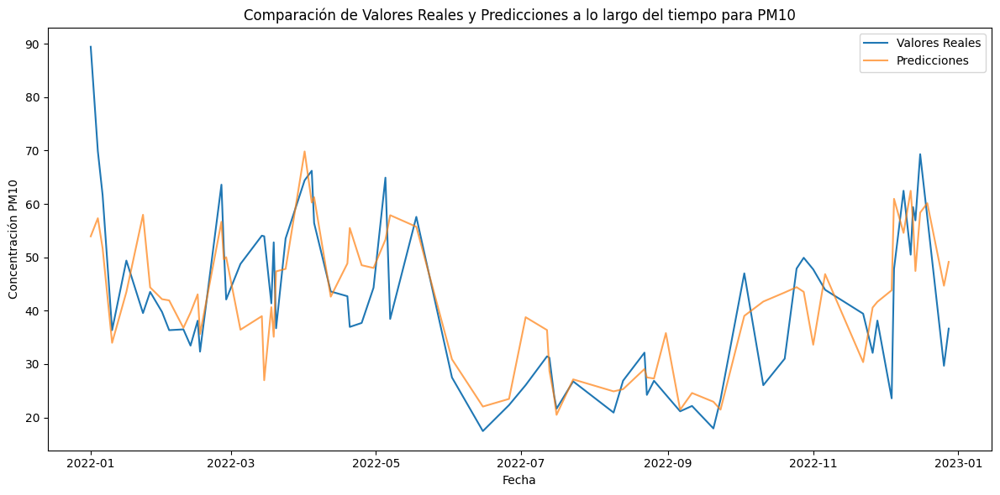

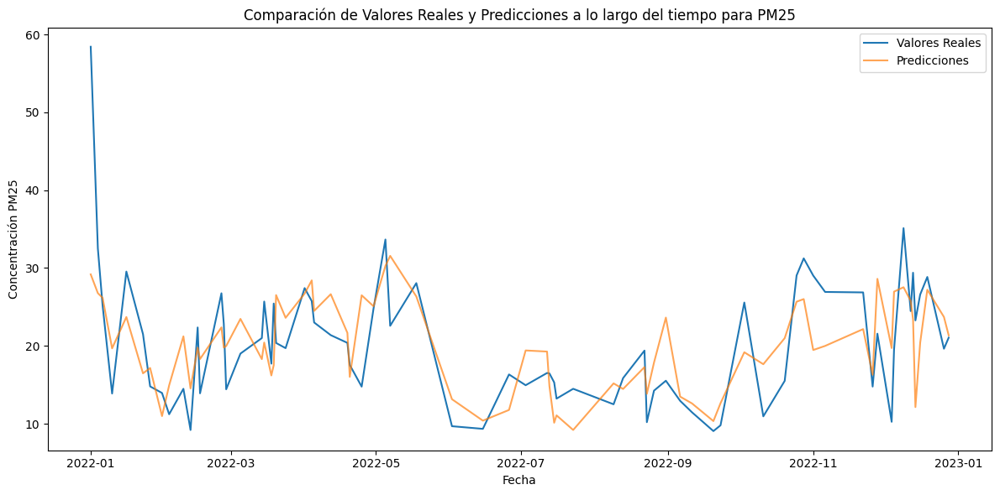

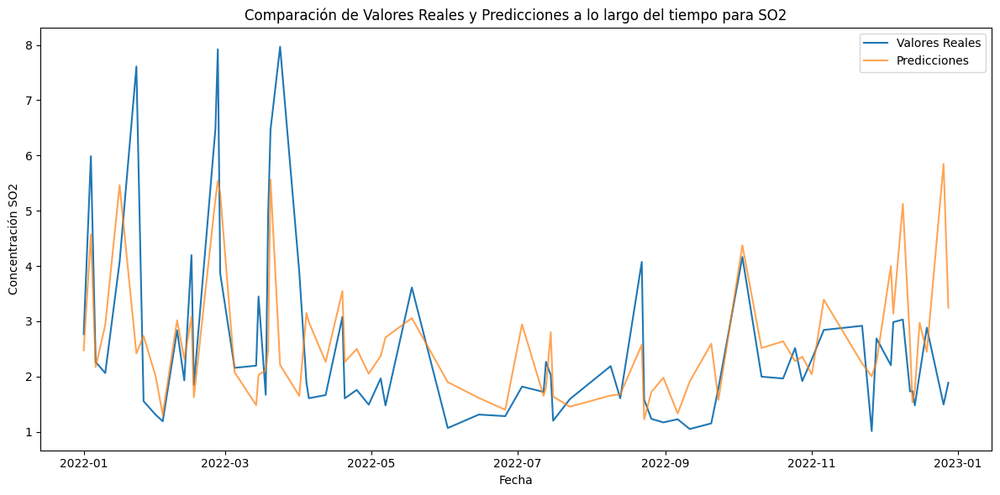

In [30]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2022, 1, 1)
end = datetime(2023, 5, 31)

# Obtener los datos diarios
weather_data = Daily(location, start, end)
weather_data = weather_data.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos solo para 2022
data_2022 = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_2022 = data_2022.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data = pd.merge(data_2022, weather_data, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_renamed = merged_data.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_renamed = merged_data_renamed.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X = merged_data_renamed[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                         'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Entrenar un modelo para cada variable objetivo y almacenar las predicciones
for target in target_variables:
    y = merged_data_renamed[target]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    predictions[target] = (X_test.index, y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE: {rmse}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    indices, y_test, y_pred = predictions[target]
    dates = merged_data_renamed.loc[indices]['fecha']

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target}')
    plt.legend()
    plt.tight_layout()
    plt.show()


CO RMSE: 0.1007263515215082
NO RMSE: 5.851121306477201
NO2 RMSE: 4.077225008938986
NOX RMSE: 8.78417855168987
O3 RMSE: 6.343789829352992
PM10 RMSE: 9.965926990495788
PM25 RMSE: 6.268836749190491
SO2 RMSE: 2.017104130364729


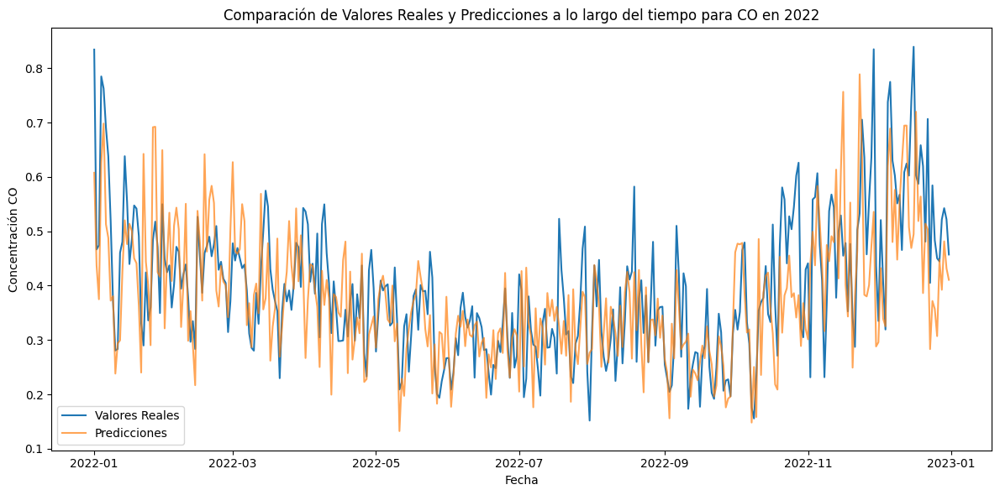

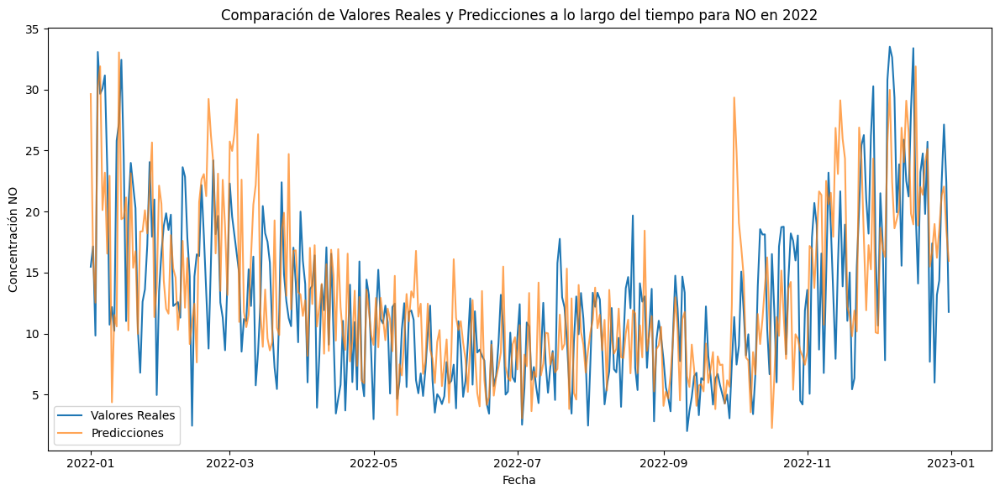

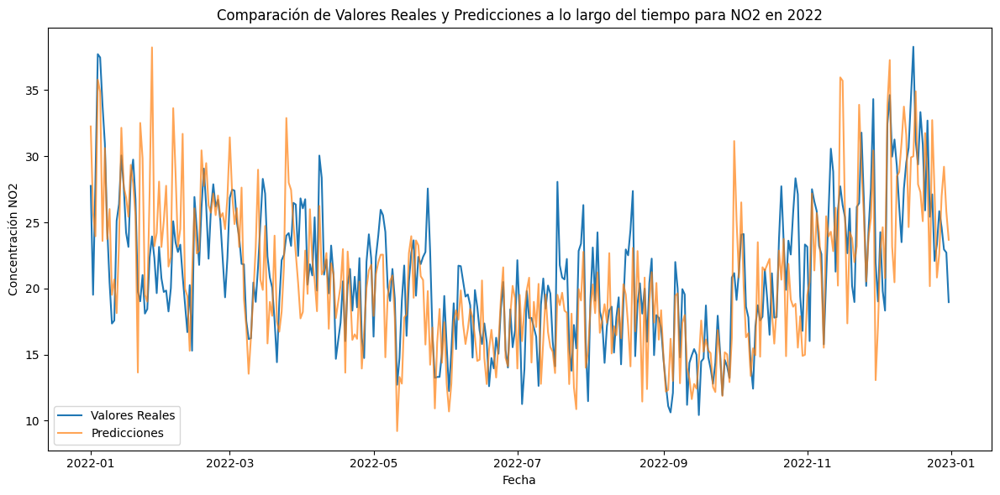

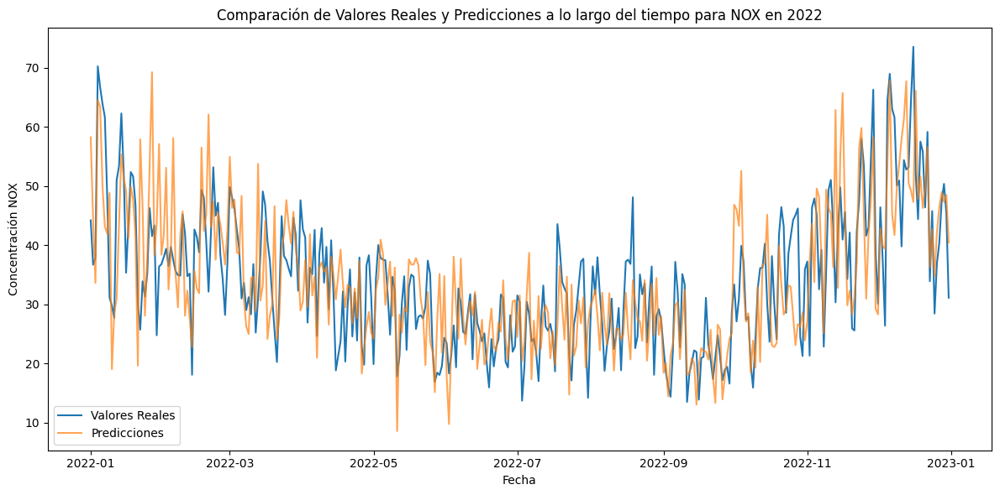

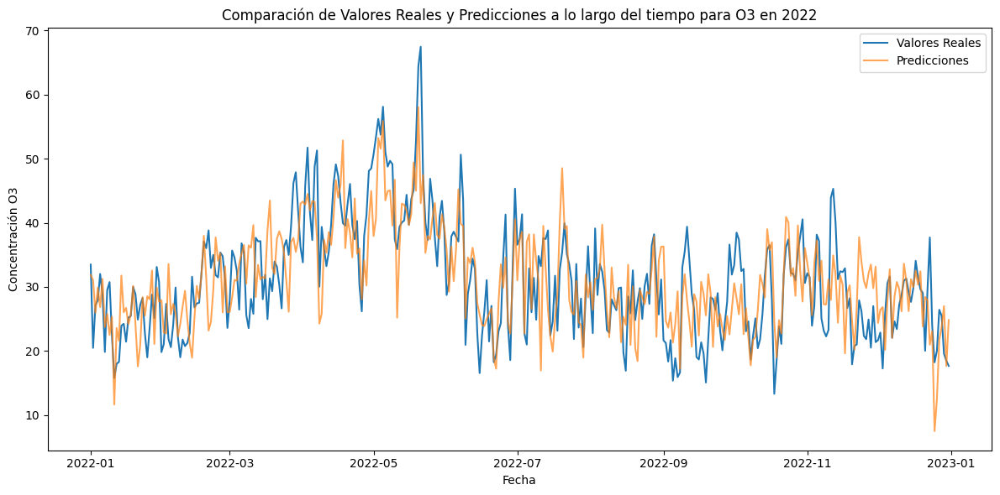

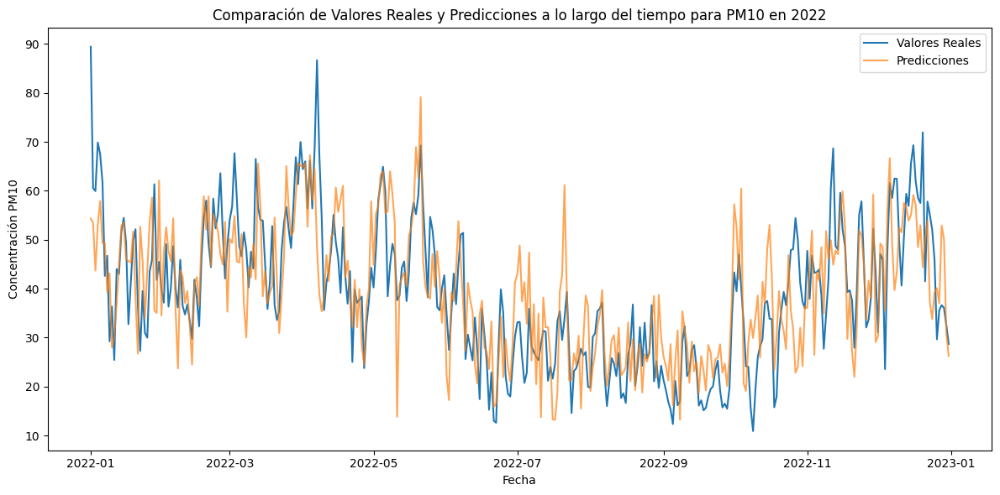

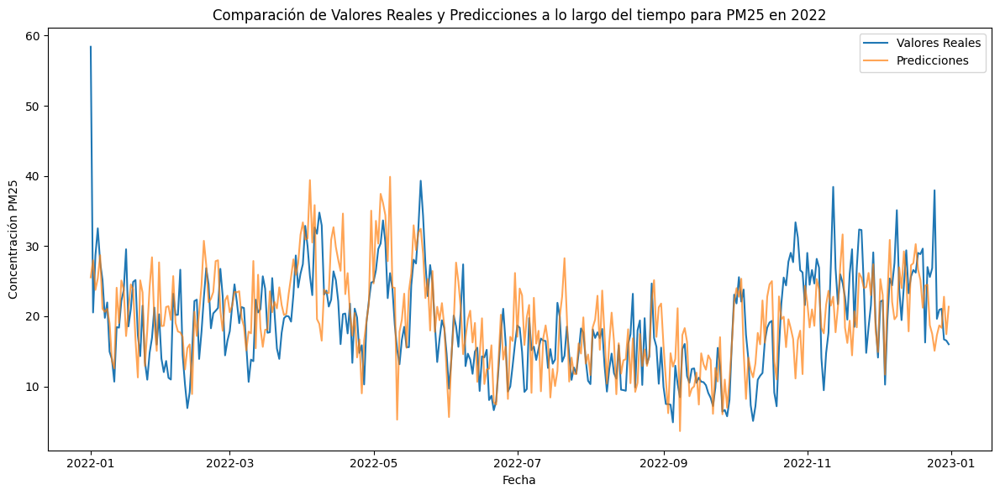

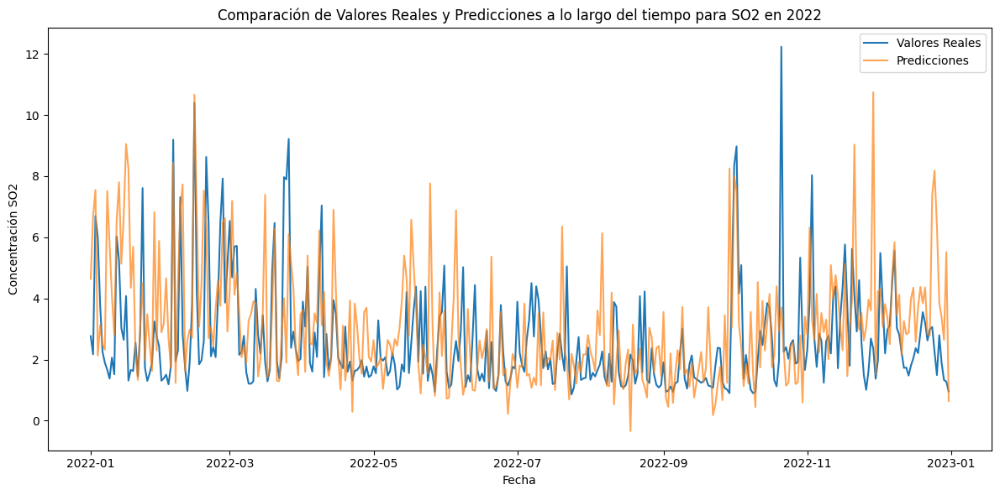

In [31]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Entrenar un modelo para cada variable objetivo y almacenar las predicciones
for target in target_variables:
    y_train = merged_data_train[target]
    y_test = merged_data_test[target]

    model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    predictions[target] = (merged_data_test['fecha'], y_test, y_pred)

    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE: {rmse}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()


CO RMSE: 0.1007263515215082
NO RMSE: 5.851121306477201
NO2 RMSE: 4.077225008938986
NOX RMSE: 8.78417855168987
O3 RMSE: 6.343789829352992
PM10 RMSE: 9.965926990495788
PM25 RMSE: 6.268836749190491
SO2 RMSE: 2.017104130364729


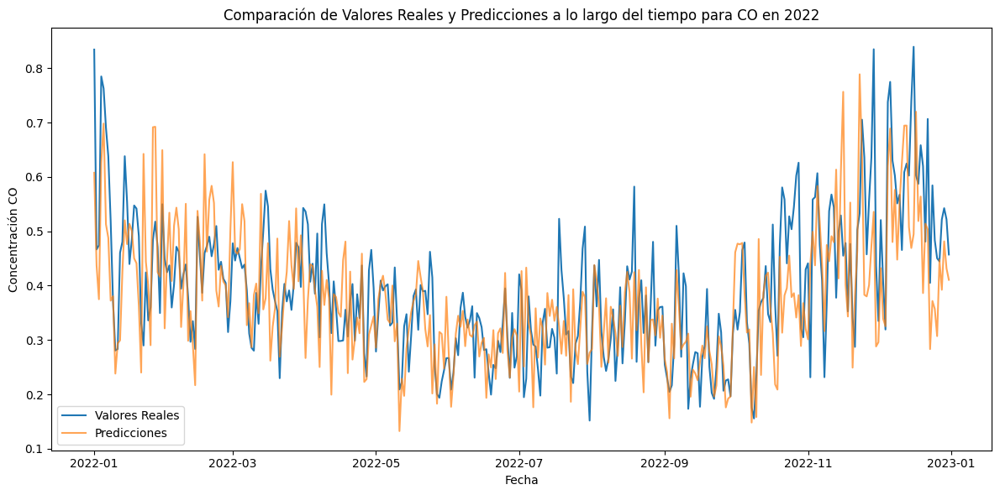

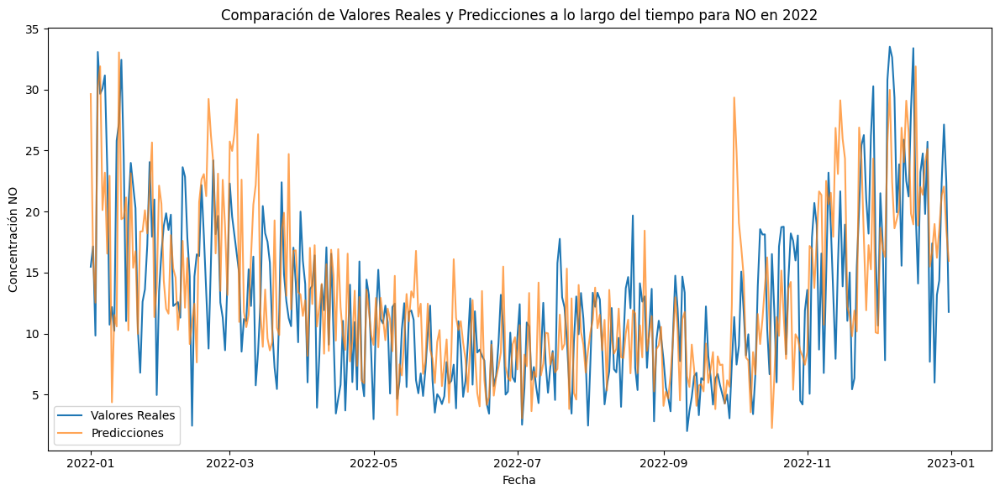

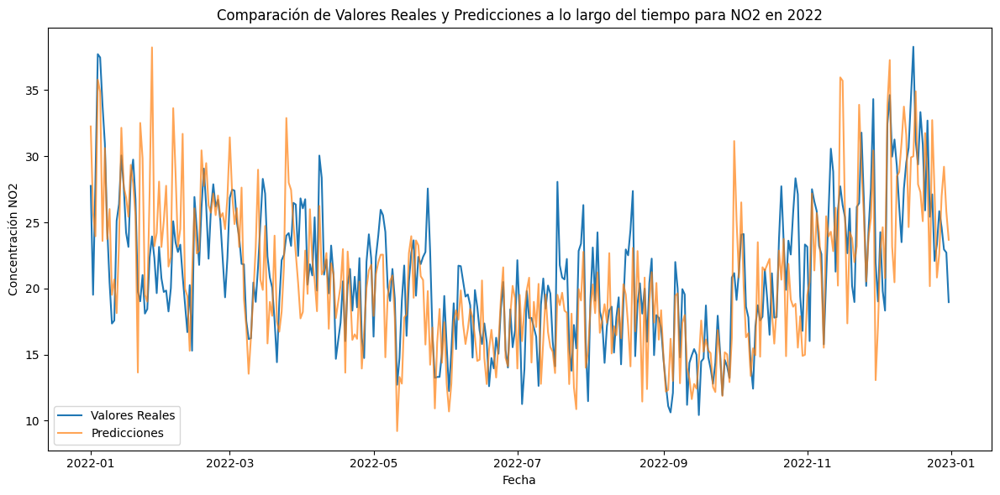

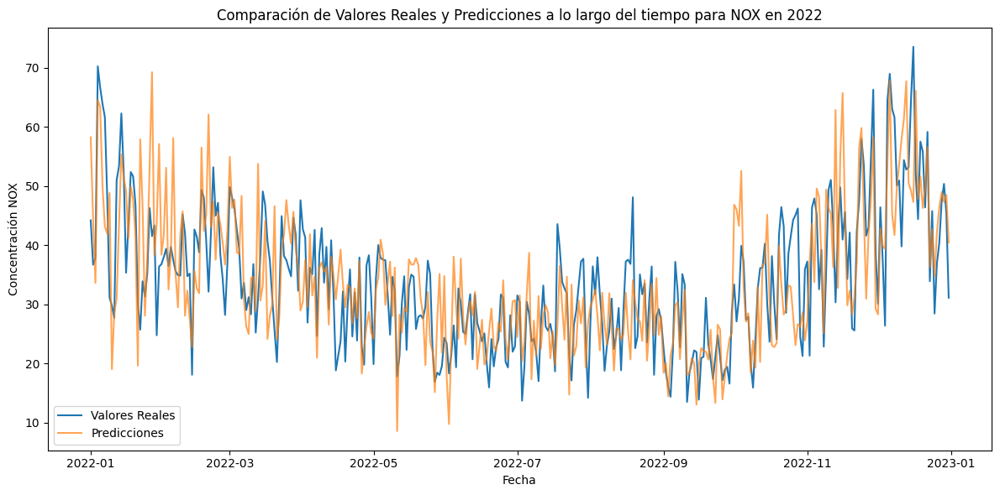

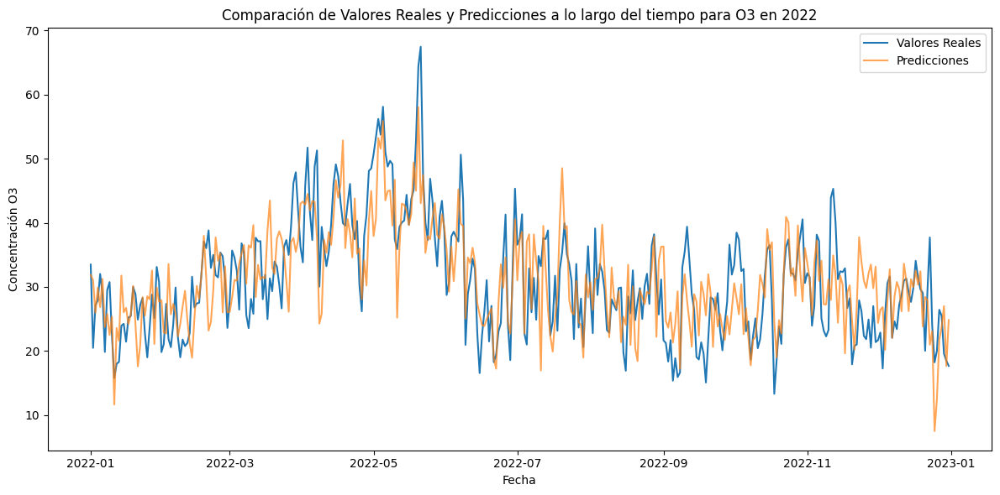

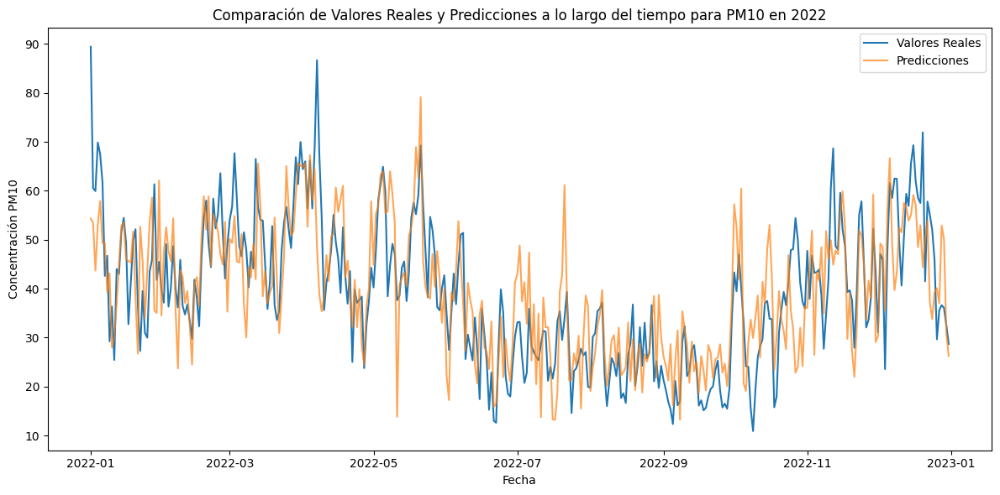

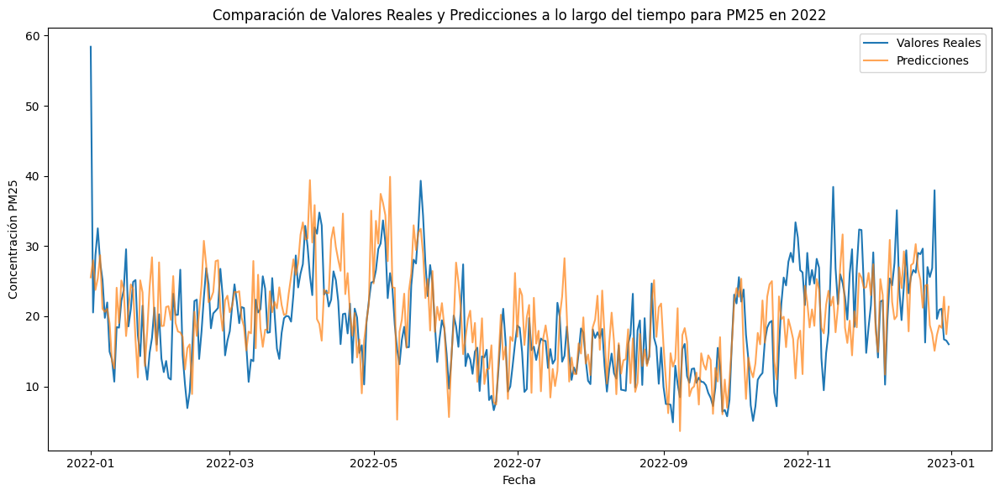

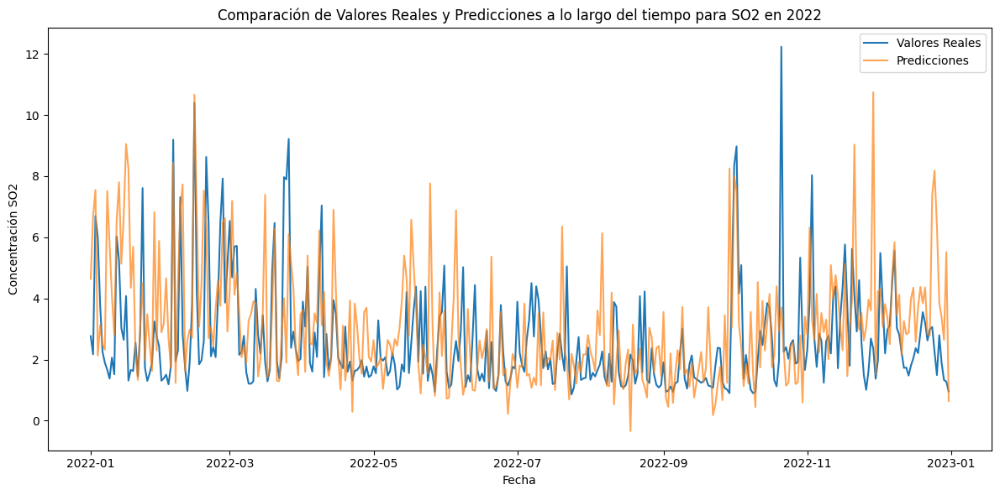

In [32]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Entrenar un modelo para cada variable objetivo y almacenar las predicciones
for target in target_variables:
    y_train = merged_data_train[target]
    y_test = merged_data_test[target]

    model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    predictions[target] = (merged_data_test['fecha'], y_test, y_pred)

    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE: {rmse}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [33]:
from sklearn.model_selection import GridSearchCV

# Definir el espacio de búsqueda de hiperparámetros
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.3],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0]
}

# Inicializar el modelo XGBoost
xgb_model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Configurar GridSearchCV
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, scoring='neg_mean_squared_error', cv=3, verbose=2)

# Realizar la búsqueda de hiperparámetros para una variable objetivo, por ejemplo, PM25
y_train = merged_data_train['PM25']
y_test = merged_data_test['PM25']
grid_search.fit(X_train, y_train)

# Obtener los mejores hiperparámetros
best_params = grid_search.best_params_
print(f'Mejores hiperparámetros: {best_params}')

# Entrenar el modelo con los mejores hiperparámetros
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# Calcular el RMSE
rmse = mean_squared_error(y_test, y_pred, squared=False)
print(f'RMSE con mejores hiperparámetros: {rmse}')


Fitting 3 folds for each of 243 candidates, totalling 729 fits
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8; total time=   0.9s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.8; total time=   1.3s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9; total time=   1.0s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9; total time=   1.0s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=0.9; total time=   0.1s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END 

Se han truncado las últimas 5000 líneas del flujo de salida.
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9; total time=   0.2s
[CV] END colsample_

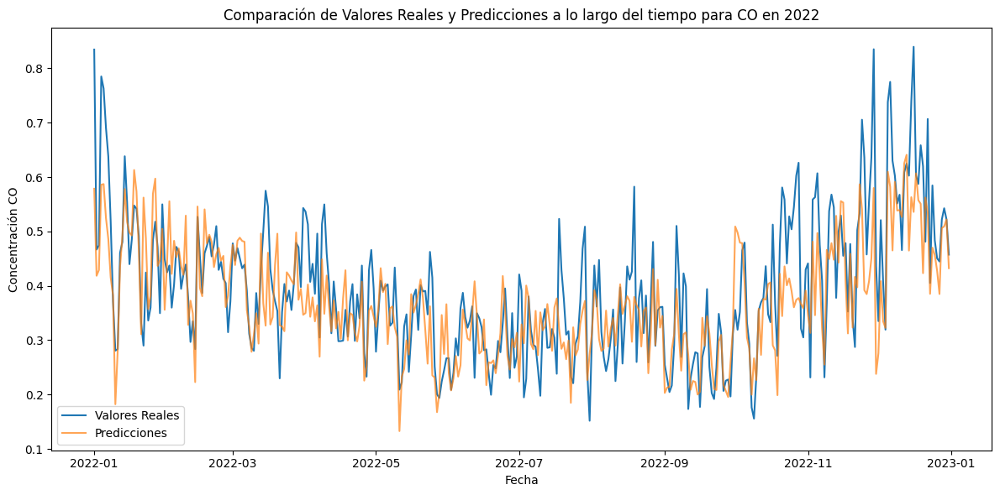

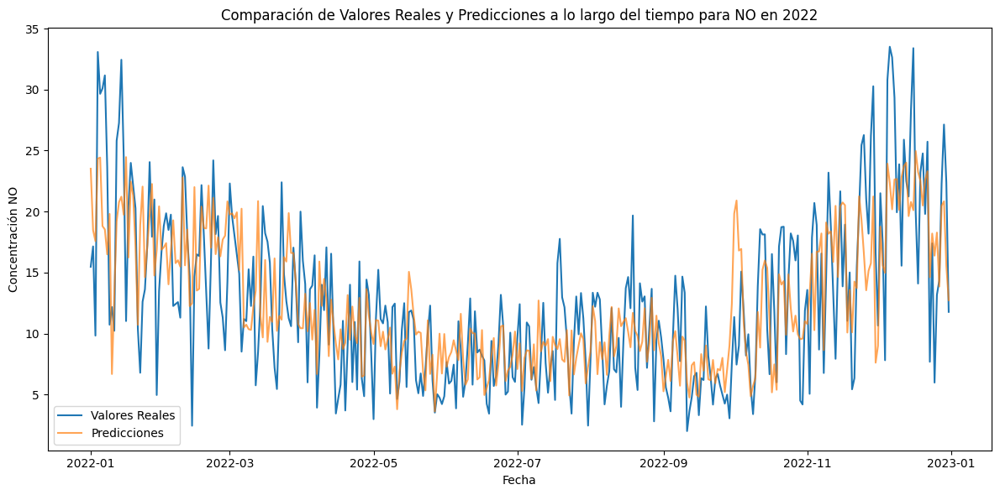

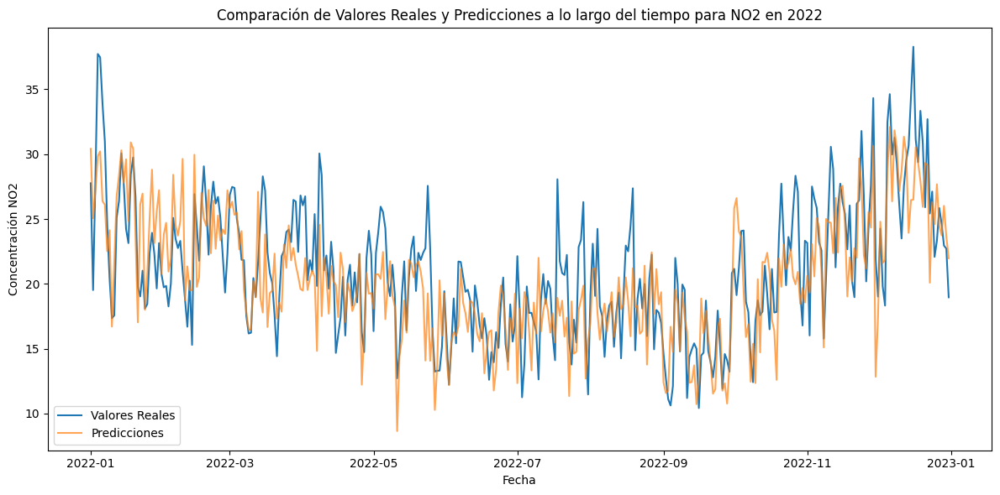

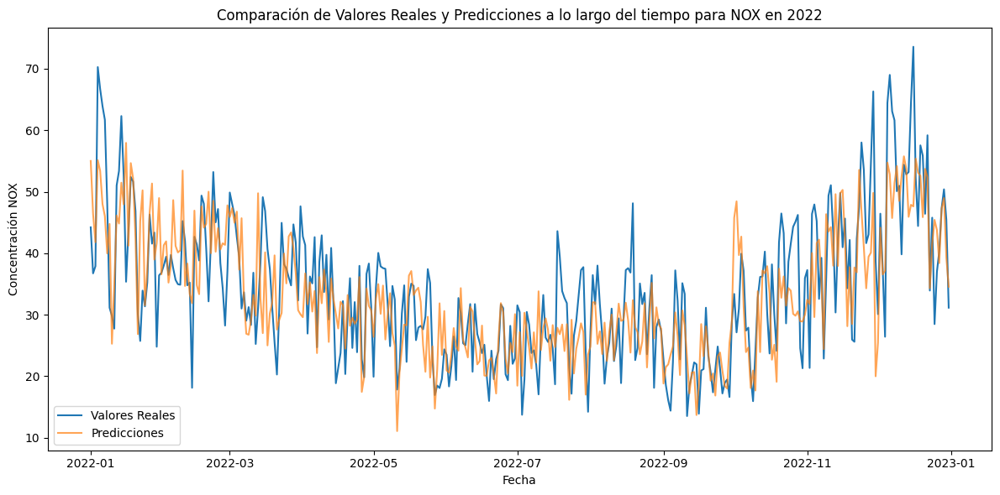

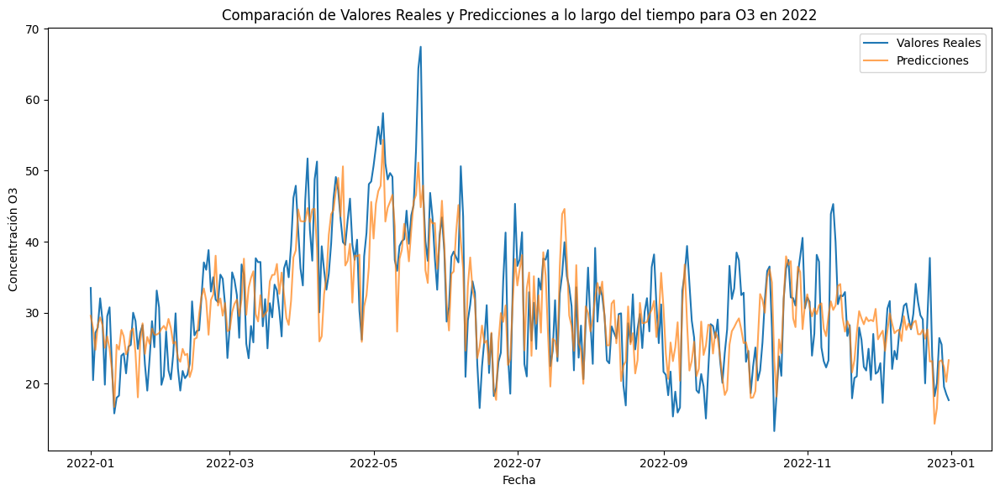

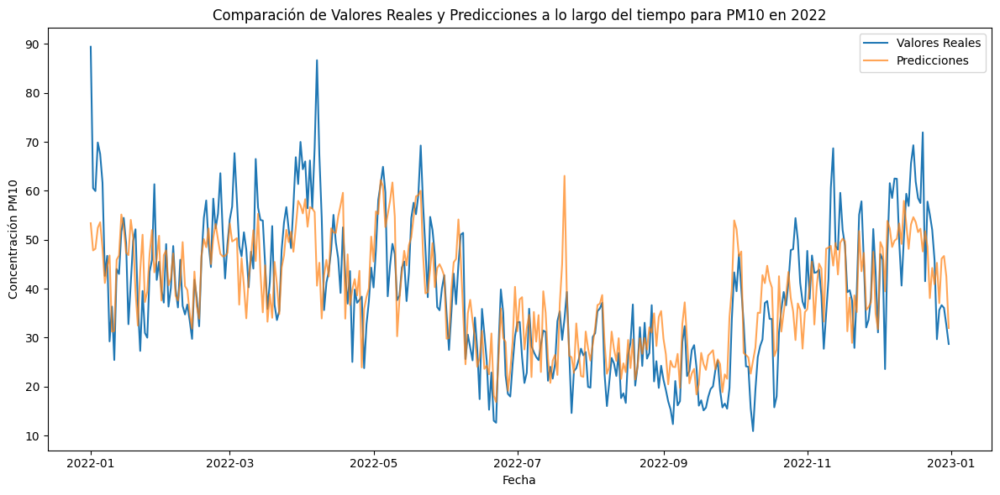

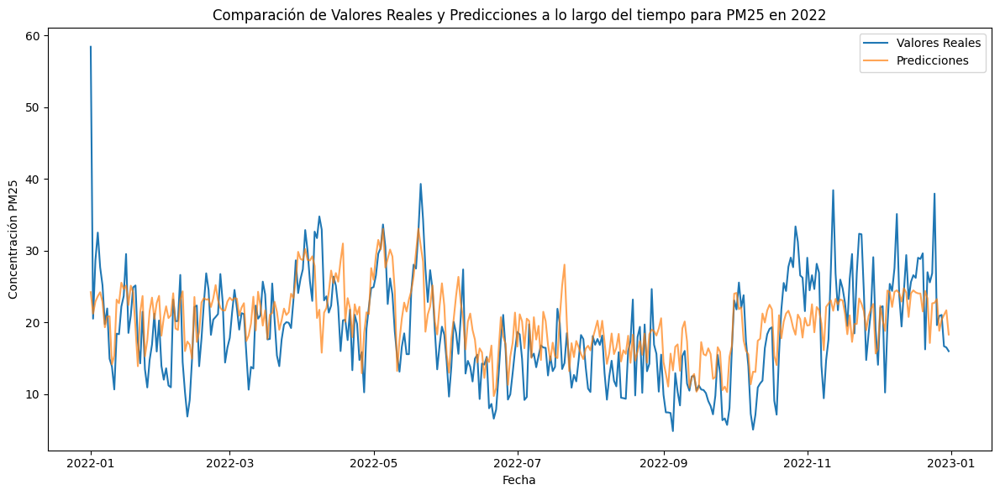

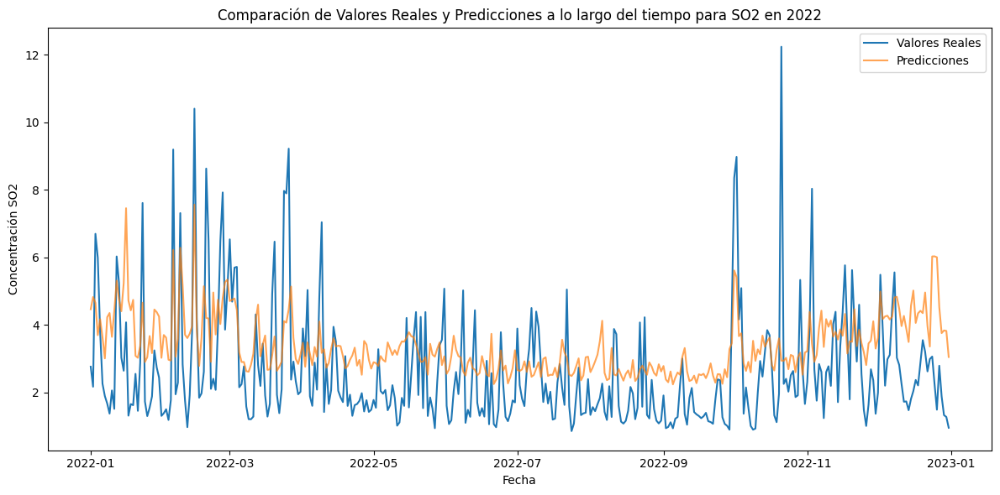

In [34]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Definir el espacio de búsqueda de hiperparámetros
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.3],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0]
}

# Entrenar un modelo para cada variable objetivo con búsqueda de hiperparámetros
for target in target_variables:
    y_train = merged_data_train[target]
    y_test = merged_data_test[target]

    # Inicializar el modelo XGBoost
    xgb_model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

    # Configurar GridSearchCV
    grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, scoring='neg_mean_squared_error', cv=3, verbose=2)

    # Realizar la búsqueda de hiperparámetros
    grid_search.fit(X_train, y_train)

    # Obtener los mejores hiperparámetros
    best_params = grid_search.best_params_
    print(f'Mejores hiperparámetros para {target}: {best_params}')

    # Entrenar el modelo con los mejores hiperparámetros
    best_model = grid_search.best_estimator_
    y_pred = best_model.predict(X_test)
    predictions[target] = (merged_data_test['fecha'], y_test, y_pred)

    # Calcular el RMSE
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE con mejores hiperparámetros: {rmse}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()


Se han truncado las últimas 5000 líneas del flujo de salida.
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9; total time=   0.2s
[CV] END colsample_

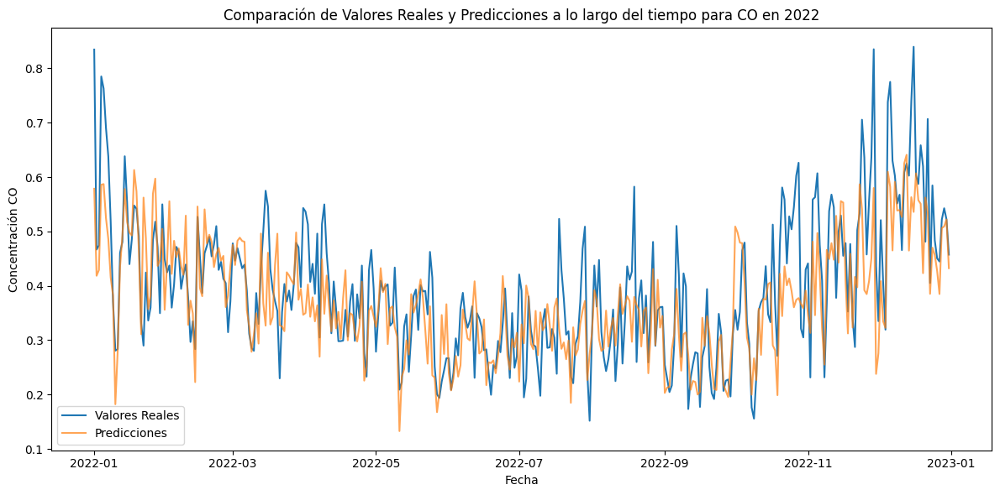

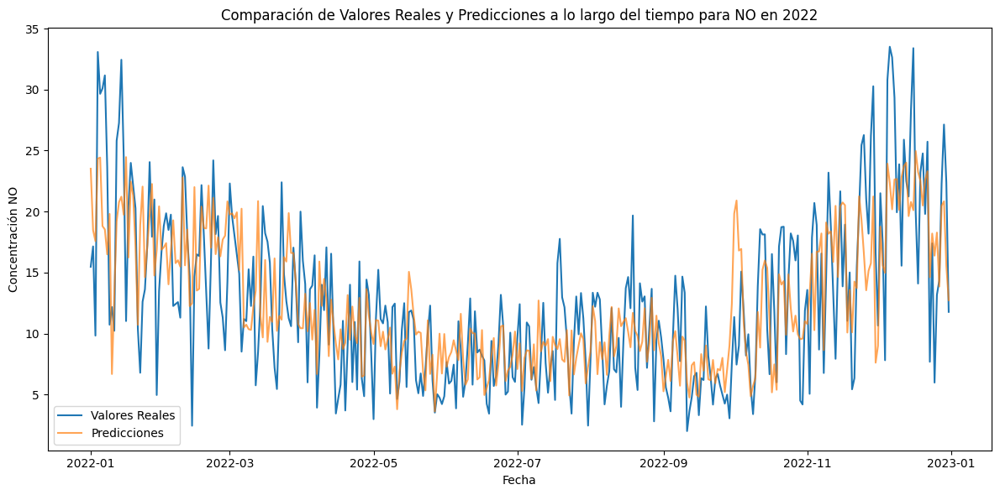

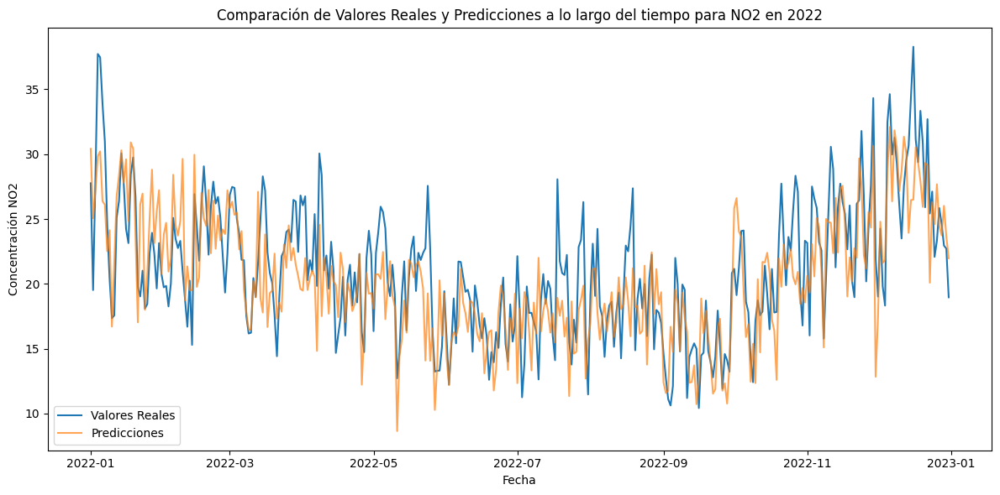

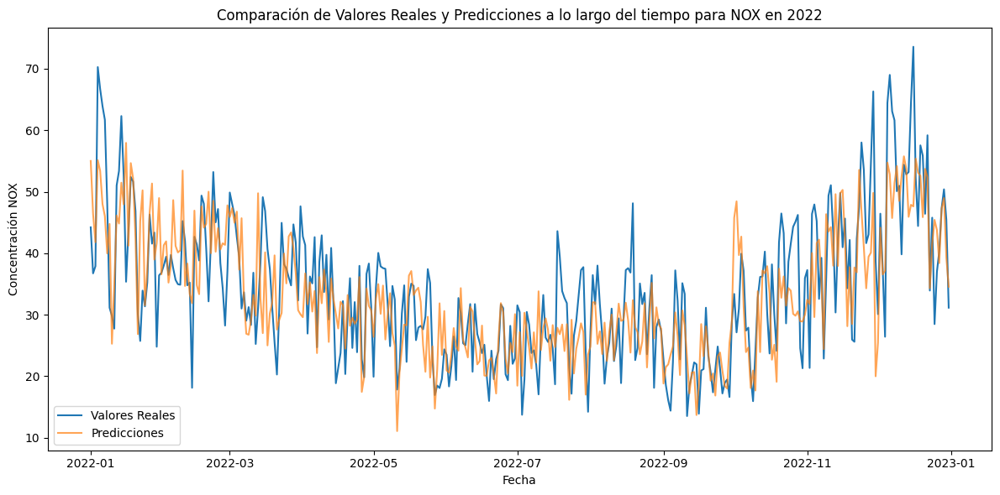

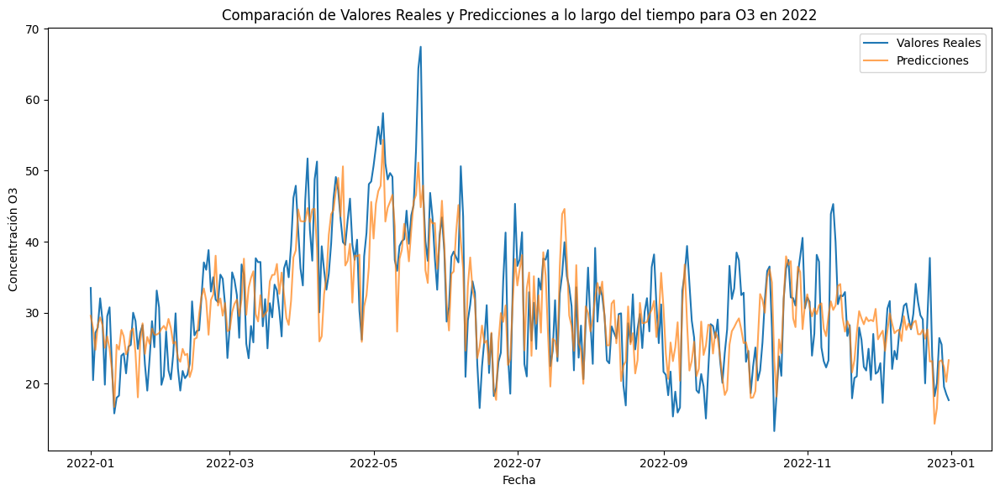

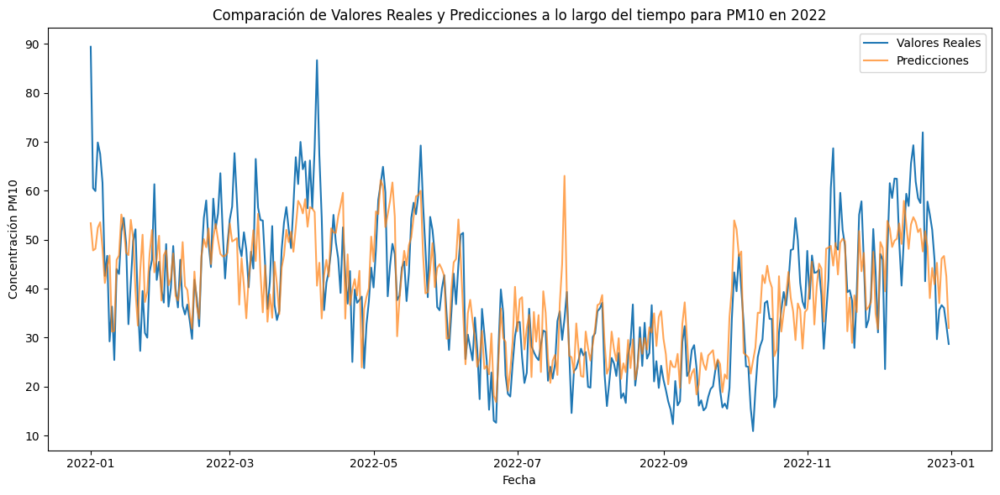

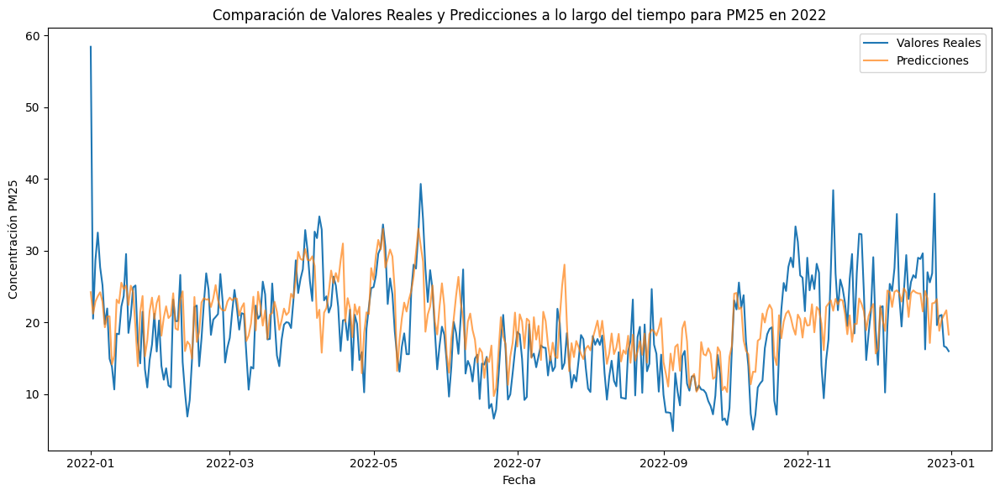

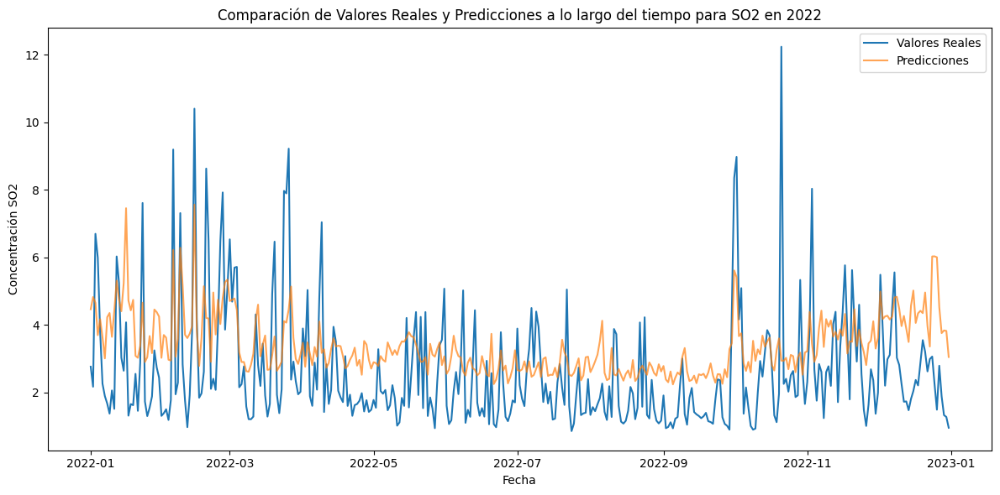

In [35]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Definir el espacio de búsqueda de hiperparámetros
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.3],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0]
}

# Entrenar un modelo para cada variable objetivo con búsqueda de hiperparámetros
for target in target_variables:
    y_train = merged_data_train[target]
    y_test = merged_data_test[target]

    # Inicializar el modelo XGBoost
    xgb_model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

    # Configurar GridSearchCV
    grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, scoring='neg_mean_squared_error', cv=3, verbose=2)

    # Realizar la búsqueda de hiperparámetros
    grid_search.fit(X_train, y_train)

    # Obtener los mejores hiperparámetros
    best_params = grid_search.best_params_
    print(f'Mejores hiperparámetros para {target}: {best_params}')

    # Entrenar el modelo con los mejores hiperparámetros
    best_model = grid_search.best_estimator_
    y_pred = best_model.predict(X_test)
    predictions[target] = (merged_data_test['fecha'], y_test, y_pred)

    # Calcular el RMSE
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE con mejores hiperparámetros: {rmse}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()


Se han truncado las últimas 5000 líneas del flujo de salida.
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9; total time=   0.2s
[CV] END colsample_

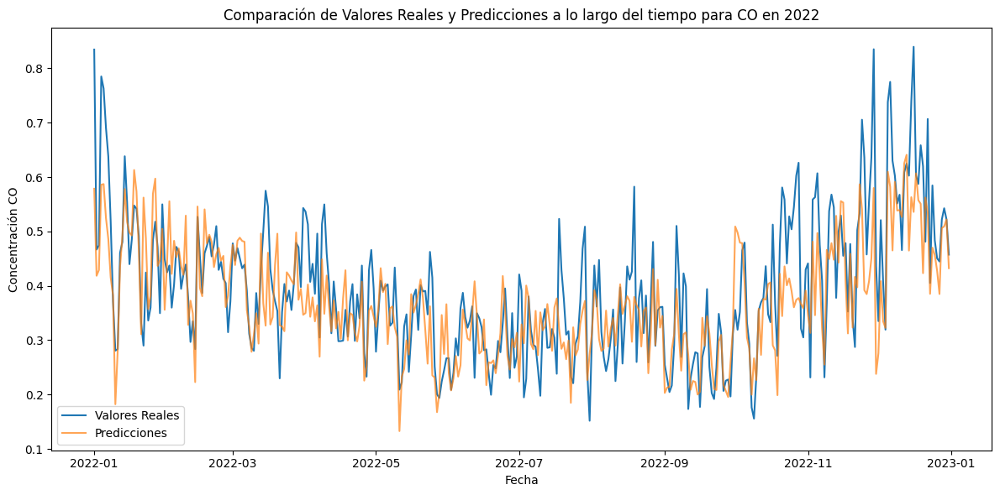

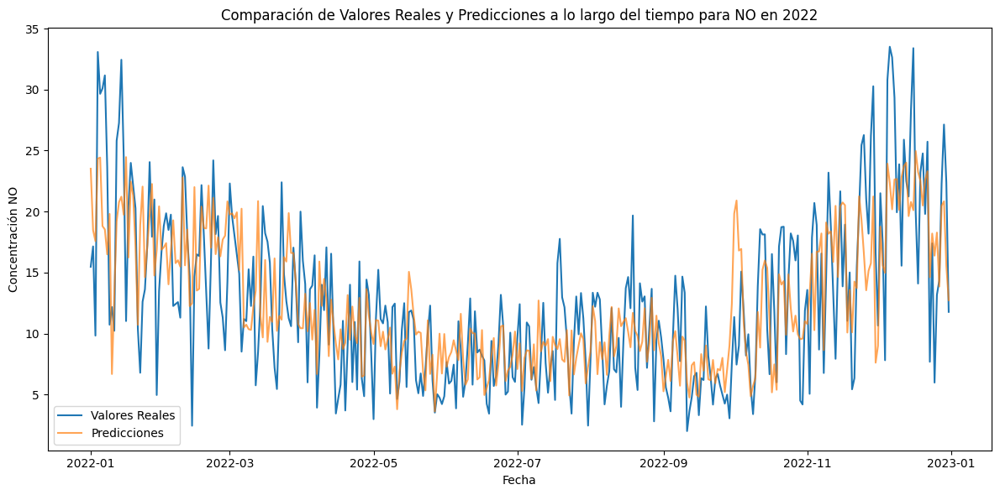

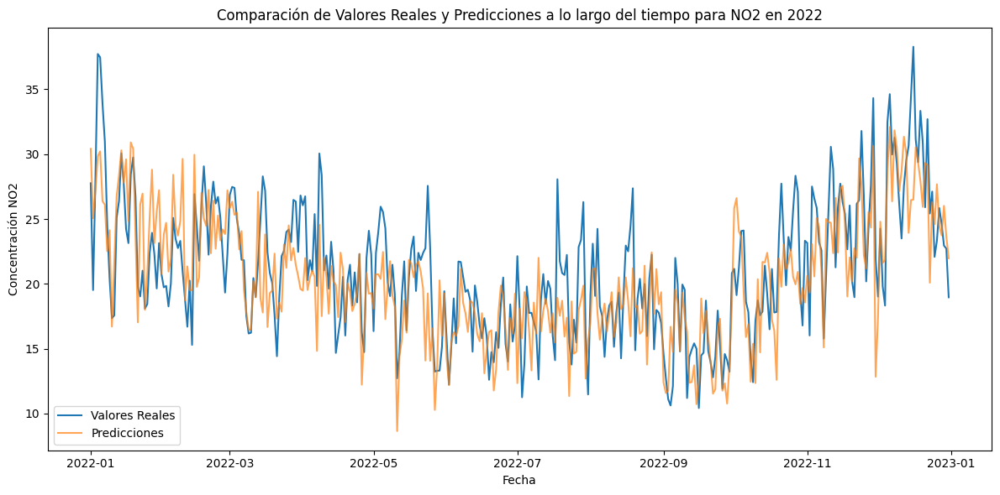

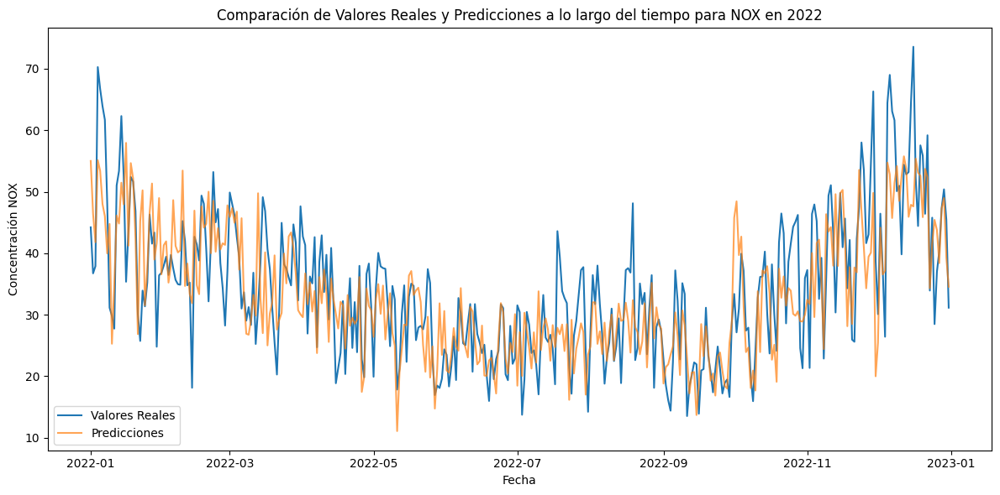

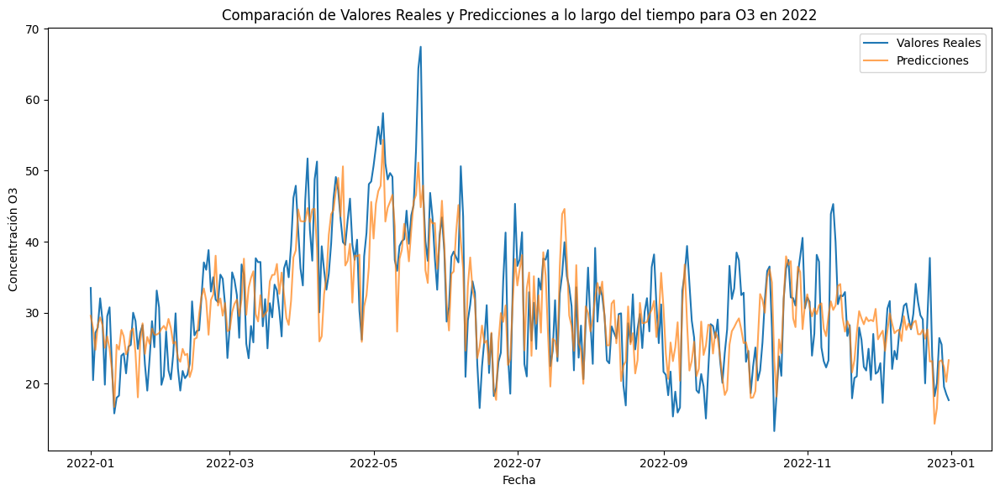

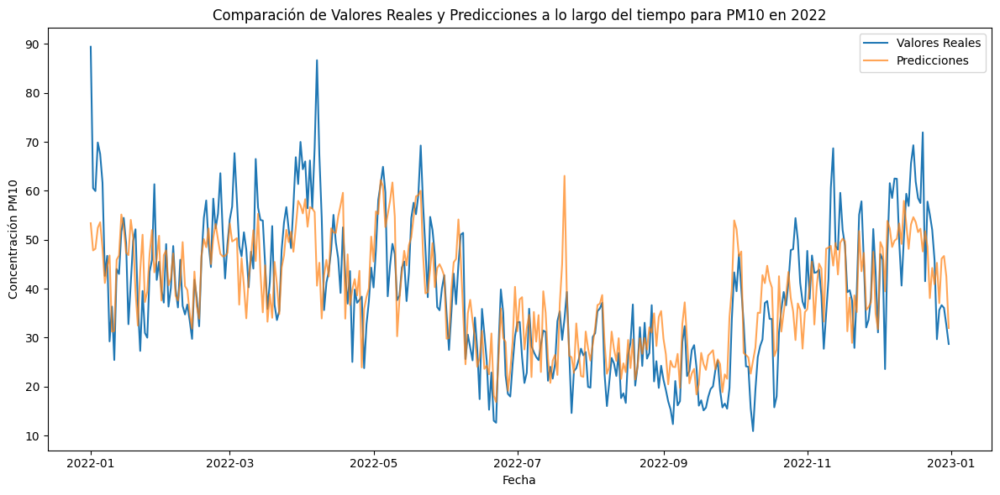

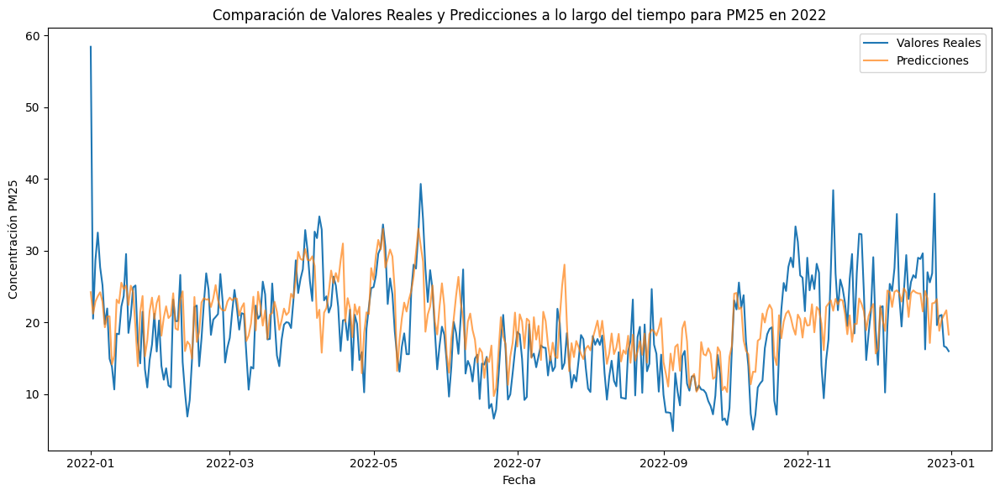

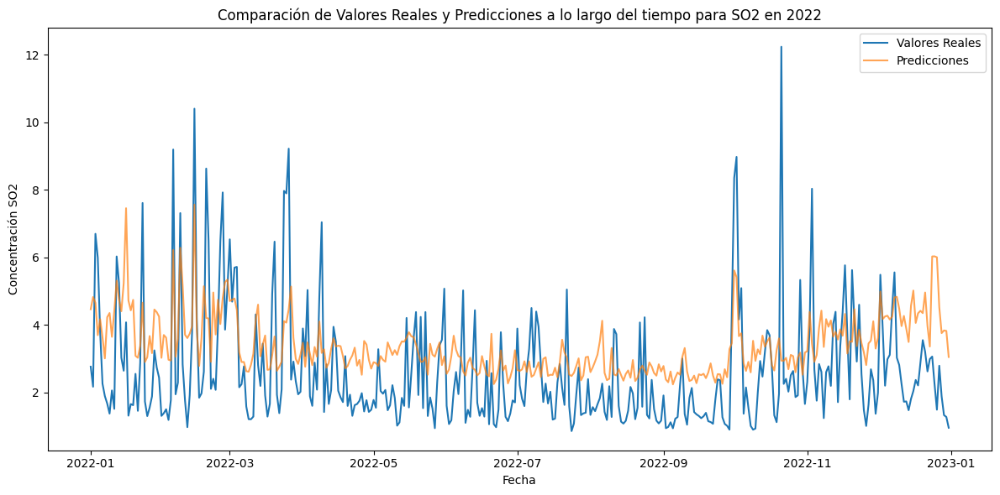

In [36]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Definir el espacio de búsqueda de hiperparámetros
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.3],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0]
}

# Entrenar un modelo para cada variable objetivo con búsqueda de hiperparámetros
for target in target_variables:
    y_train = merged_data_train[target]
    y_test = merged_data_test[target]

    # Inicializar el modelo XGBoost
    xgb_model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

    # Configurar GridSearchCV
    grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, scoring='neg_mean_squared_error', cv=3, verbose=2)

    # Realizar la búsqueda de hiperparámetros
    grid_search.fit(X_train, y_train)

    # Obtener los mejores hiperparámetros
    best_params = grid_search.best_params_
    print(f'Mejores hiperparámetros para {target}: {best_params}')

    # Entrenar el modelo con los mejores hiperparámetros
    best_model = grid_search.best_estimator_
    y_pred = best_model.predict(X_test)
    predictions[target] = (merged_data_test['fecha'], y_test, y_pred)

    # Calcular el RMSE
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE con mejores hiperparámetros: {rmse}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()


Se han truncado las últimas 5000 líneas del flujo de salida.
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.8; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9; total time=   0.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.9; total time=   0.2s
[CV] END colsample_

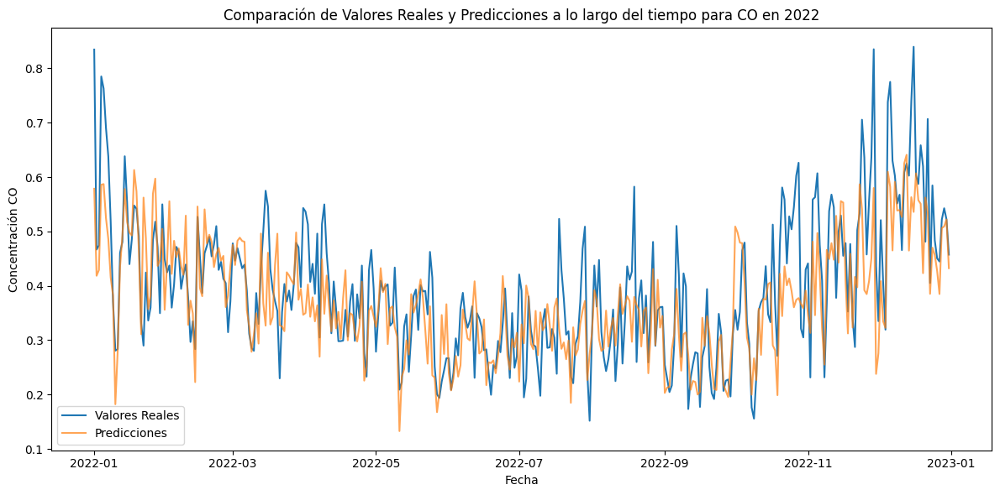

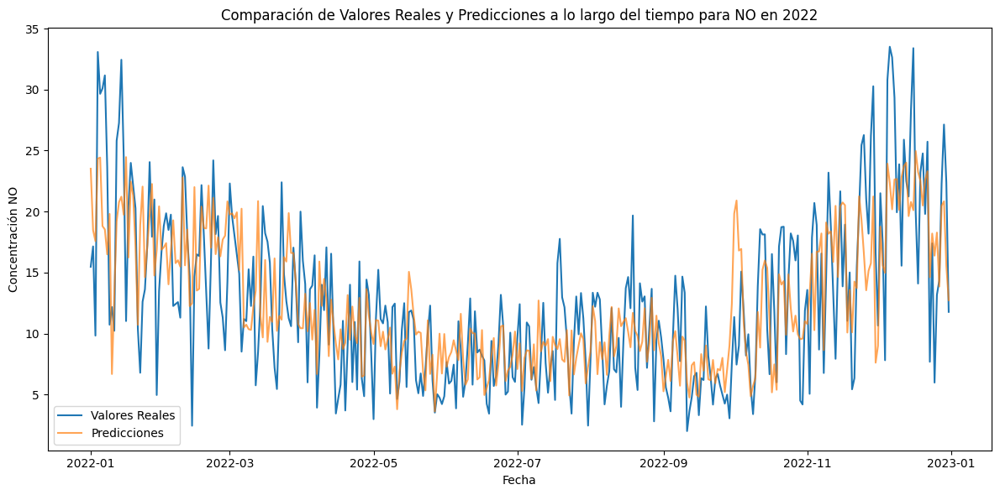

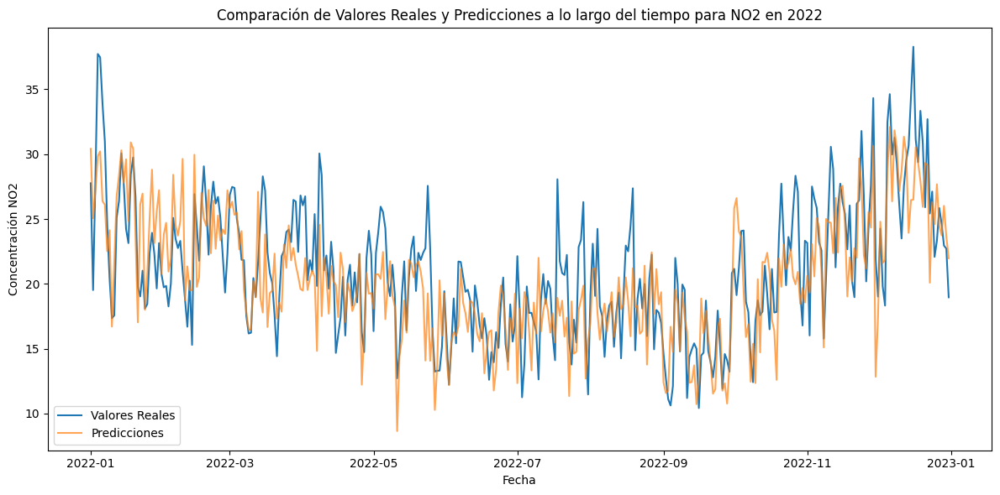

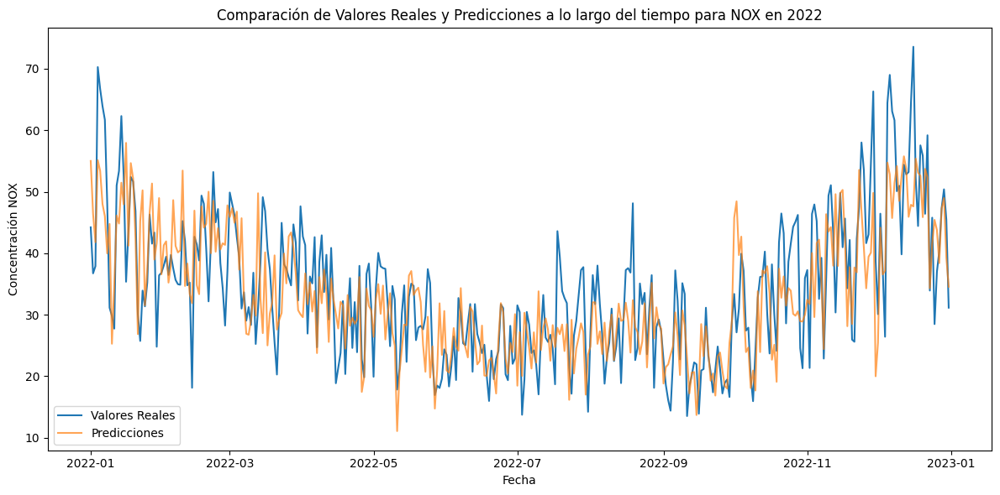

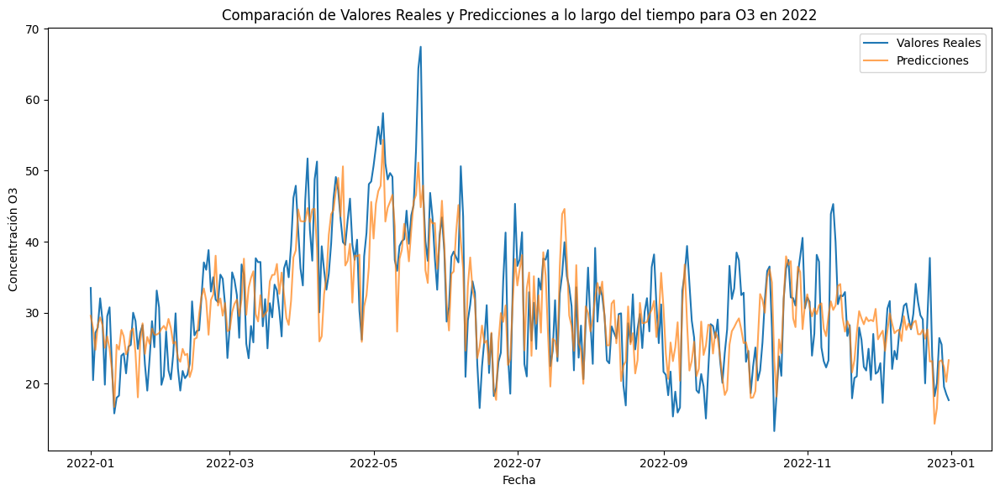

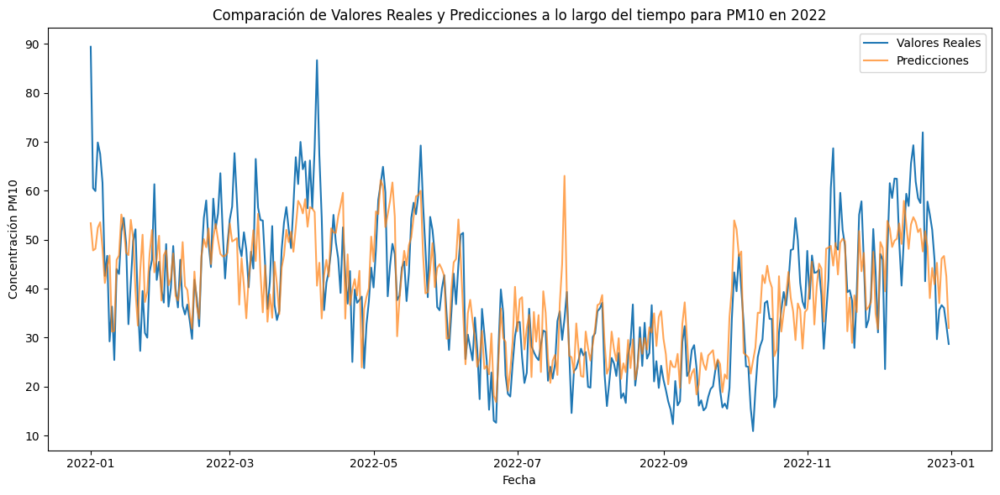

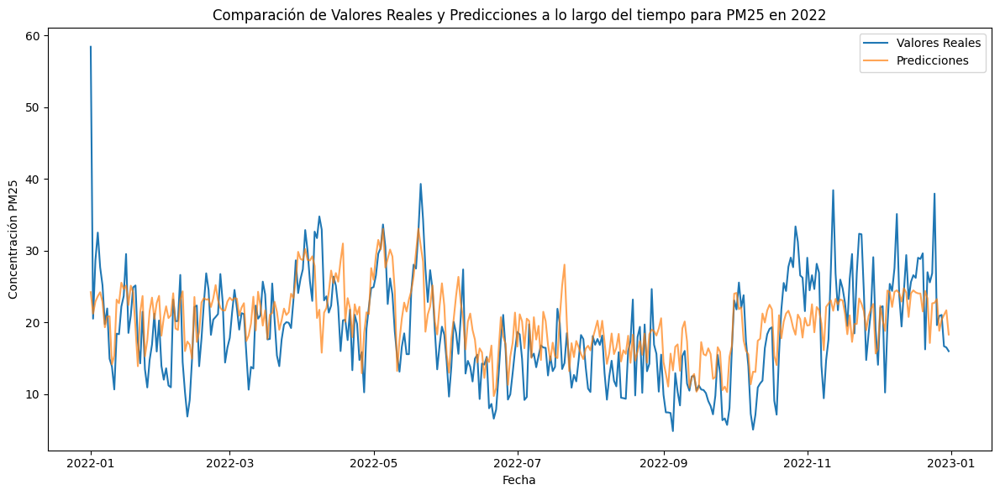

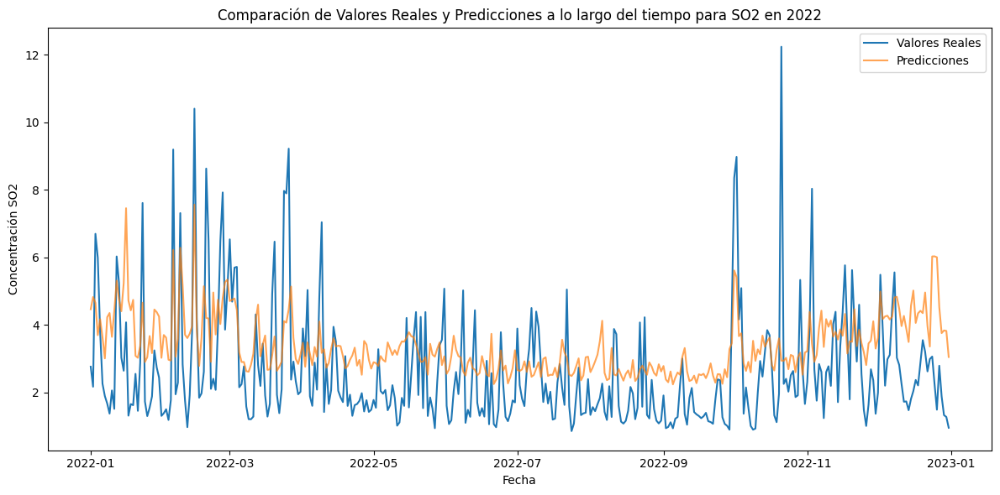

In [37]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Definir el espacio de búsqueda de hiperparámetros
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.3],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0]
}

# Entrenar un modelo para cada variable objetivo con búsqueda de hiperparámetros
for target in target_variables:
    y_train = merged_data_train[target]
    y_test = merged_data_test[target]

    # Inicializar el modelo XGBoost
    xgb_model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

    # Configurar GridSearchCV
    grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, scoring='neg_mean_squared_error', cv=3, verbose=2)

    # Realizar la búsqueda de hiperparámetros
    grid_search.fit(X_train, y_train)

    # Obtener los mejores hiperparámetros
    best_params = grid_search.best_params_
    print(f'Mejores hiperparámetros para {target}: {best_params}')

    # Entrenar el modelo con los mejores hiperparámetros
    best_model = grid_search.best_estimator_
    y_pred = best_model.predict(X_test)
    predictions[target] = (merged_data_test['fecha'], y_test, y_pred)

    # Calcular el RMSE
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE con mejores hiperparámetros: {rmse}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()


PM25 RMSE con Stacking: 5.876508569273247


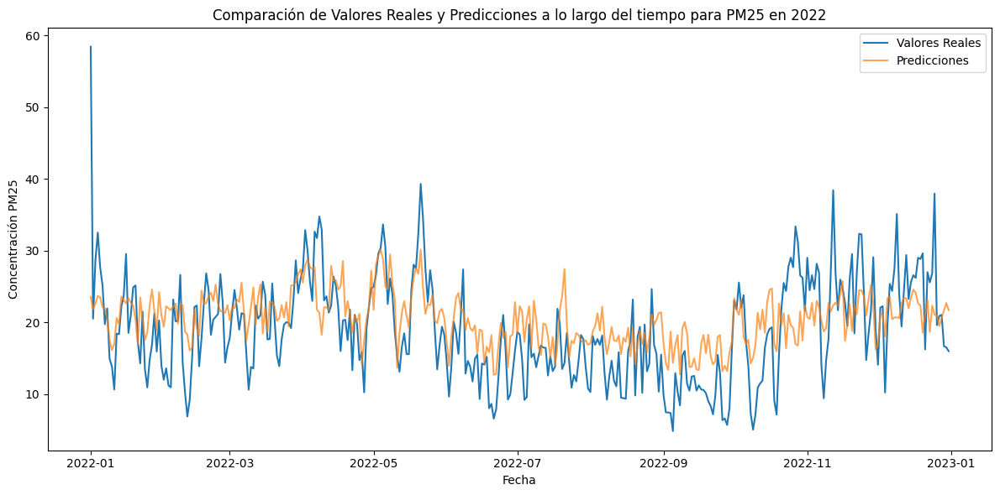

In [38]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variable objetivo (Ejemplo: PM25)
y_train = merged_data_train['PM25']
y_test = merged_data_test['PM25']

# Definir los modelos base
base_models = [
    ('dt', DecisionTreeRegressor()),
    ('rf', RandomForestRegressor(n_estimators=100)),
    ('xgb', xgb.XGBRegressor(objective='reg:squarederror', random_state=42))
]

# Definir el modelo de meta-aprendizaje
meta_model = RidgeCV()

# Crear el modelo de Stacking
stacking_model = StackingRegressor(estimators=base_models, final_estimator=meta_model, cv=3)

# Entrenar el modelo de Stacking
stacking_model.fit(X_train, y_train)

# Realizar predicciones
y_pred = stacking_model.predict(X_test)

# Calcular el RMSE
rmse = mean_squared_error(y_test, y_pred, squared=False)
print(f'PM25 RMSE con Stacking: {rmse}')

# Crear DataFrame de comparación
comparison_df = pd.DataFrame({
    'Fecha': merged_data_test['fecha'],
    'Actual': y_test.values,
    'Predicted': y_pred
}).sort_values('Fecha')

# Graficar los valores reales y predichos
plt.figure(figsize=(12, 6))
plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
plt.xlabel('Fecha')
plt.ylabel('Concentración PM25')
plt.title('Comparación de Valores Reales y Predicciones a lo largo del tiempo para PM25 en 2022')
plt.legend()
plt.tight_layout()
plt.show()


CO RMSE con Stacking: 0.12295462044772461
NO RMSE con Stacking: 5.47924806020127
NO2 RMSE con Stacking: 3.6591267127024047
NOX RMSE con Stacking: 8.337037549571354
O3 RMSE con Stacking: 6.149996796680562
PM10 RMSE con Stacking: 9.388227606925636
PM25 RMSE con Stacking: 5.941092541120065
SO2 RMSE con Stacking: 1.9611129526071756


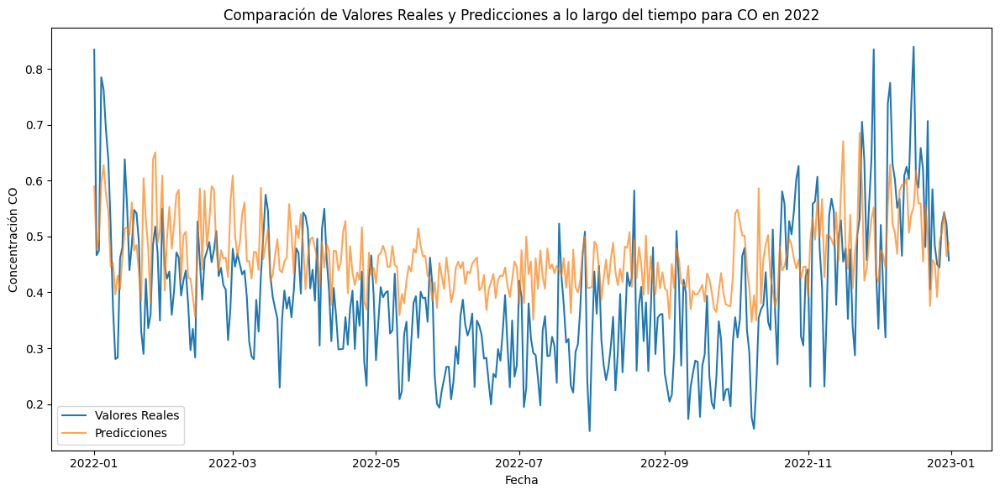

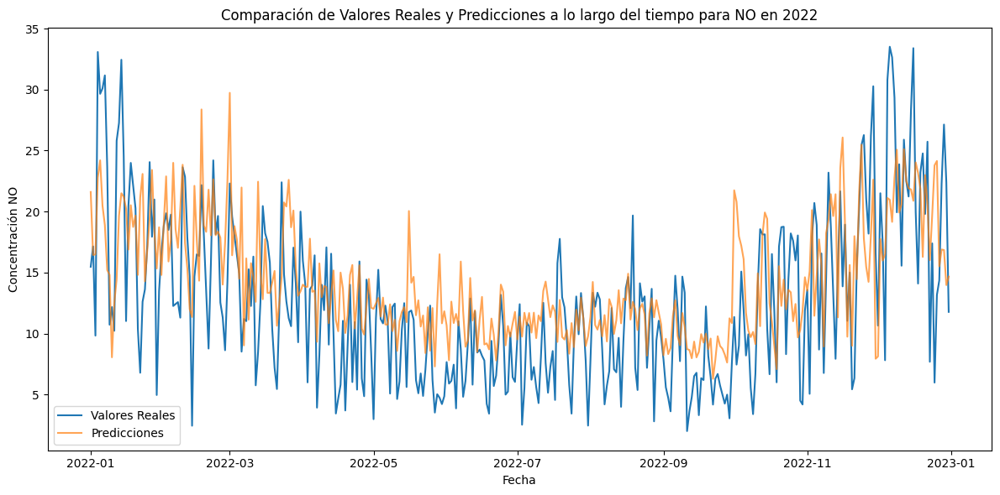

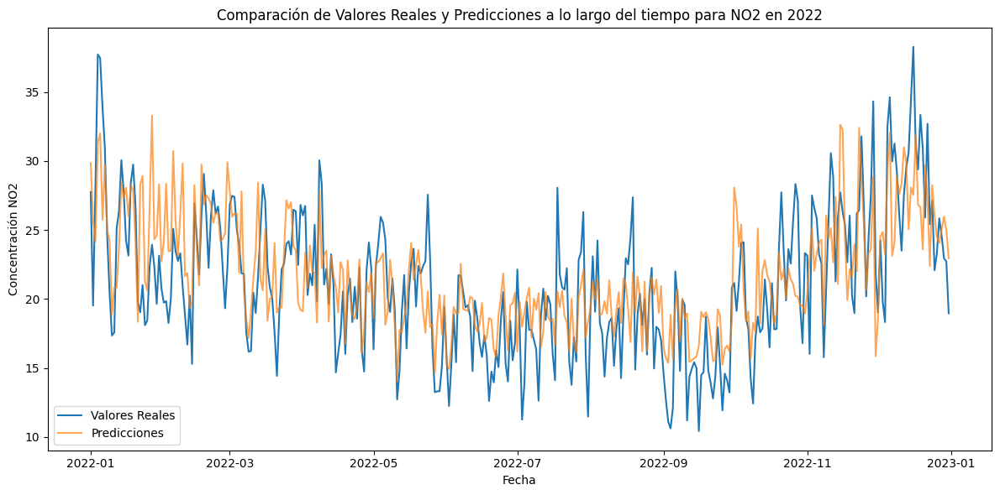

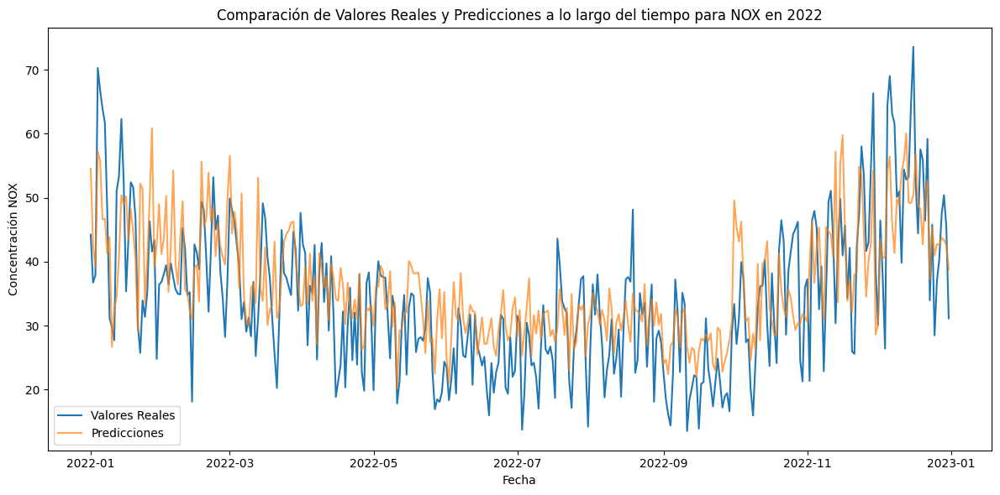

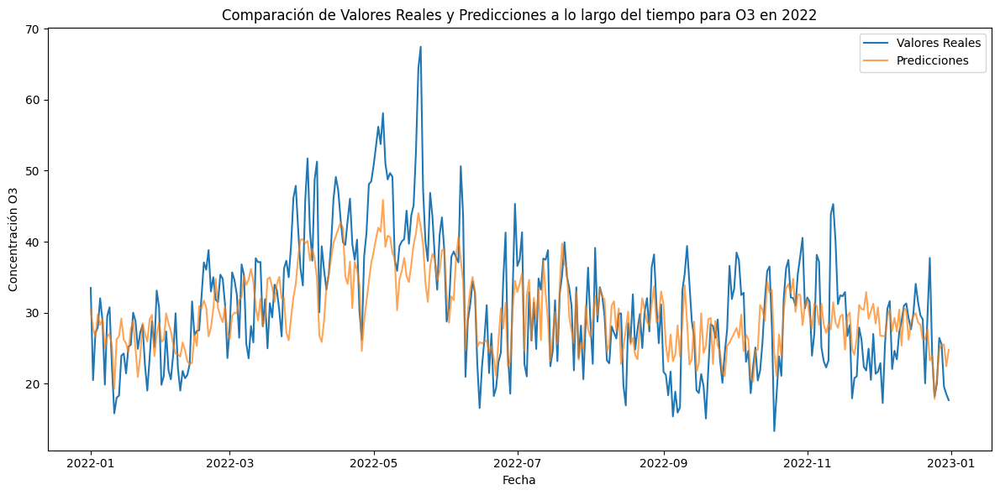

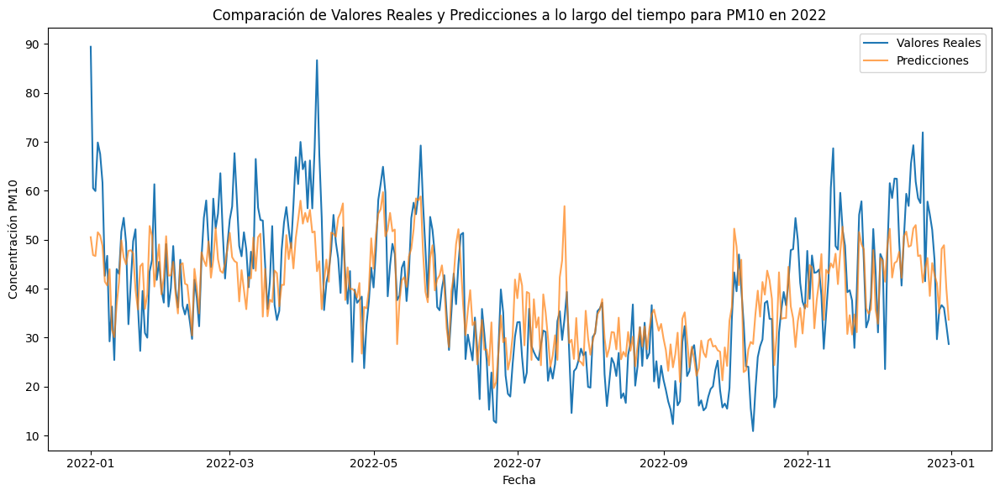

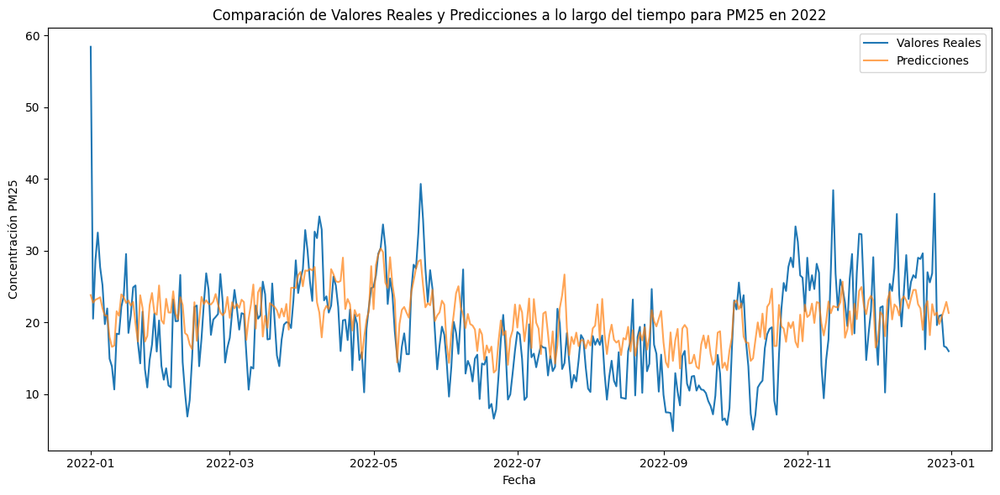

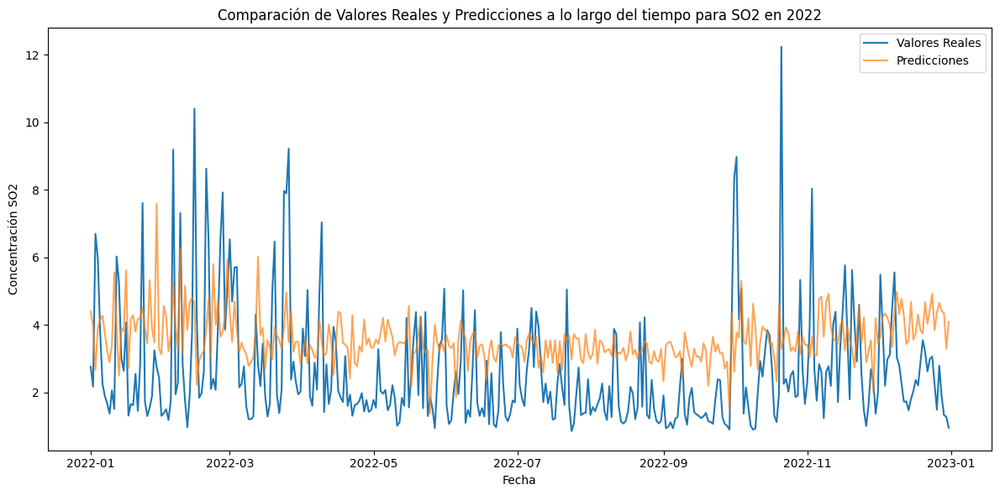

In [39]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Definir los modelos base
base_models = [
    ('dt', DecisionTreeRegressor()),
    ('rf', RandomForestRegressor(n_estimators=100)),
    ('xgb', xgb.XGBRegressor(objective='reg:squarederror', random_state=42))
]

# Definir el modelo de meta-aprendizaje
meta_model = RidgeCV()

# Entrenar un modelo de Stacking para cada variable objetivo
for target in target_variables:
    y_train = merged_data_train[target]
    y_test = merged_data_test[target]

    # Crear el modelo de Stacking
    stacking_model = StackingRegressor(estimators=base_models, final_estimator=meta_model, cv=3)

    # Entrenar el modelo de Stacking
    stacking_model.fit(X_train, y_train)

    # Realizar predicciones
    y_pred = stacking_model.predict(X_test)
    predictions[target] = (merged_data_test['fecha'], y_test, y_pred)

    # Calcular el RMSE
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{target} RMSE con Stacking: {rmse}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()


Fitting 3 folds for each of 48 candidates, totalling 144 fits
[CV] END .................C=0.1, epsilon=0.01, kernel=linear; total time=   8.9s
[CV] END .................C=0.1, epsilon=0.01, kernel=linear; total time=   4.1s
[CV] END .................C=0.1, epsilon=0.01, kernel=linear; total time=  10.4s
[CV] END ...................C=0.1, epsilon=0.01, kernel=poly; total time=   0.2s
[CV] END ...................C=0.1, epsilon=0.01, kernel=poly; total time=   0.2s
[CV] END ...................C=0.1, epsilon=0.01, kernel=poly; total time=   0.2s
[CV] END ....................C=0.1, epsilon=0.01, kernel=rbf; total time=   0.2s
[CV] END ....................C=0.1, epsilon=0.01, kernel=rbf; total time=   0.2s
[CV] END ....................C=0.1, epsilon=0.01, kernel=rbf; total time=   0.2s
[CV] END ..................C=0.1, epsilon=0.1, kernel=linear; total time=   6.2s
[CV] END ..................C=0.1, epsilon=0.1, kernel=linear; total time=   5.2s
[CV] END ..................C=0.1, epsilon=0.1, 

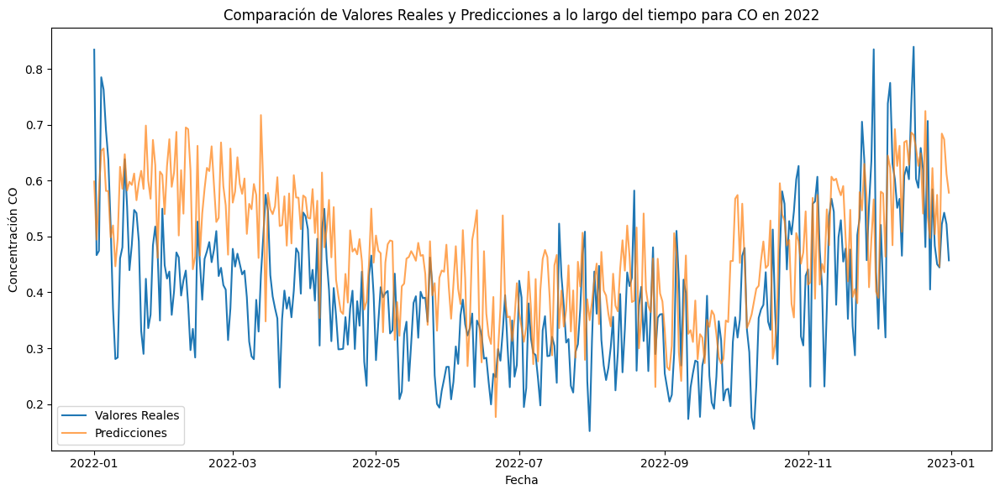

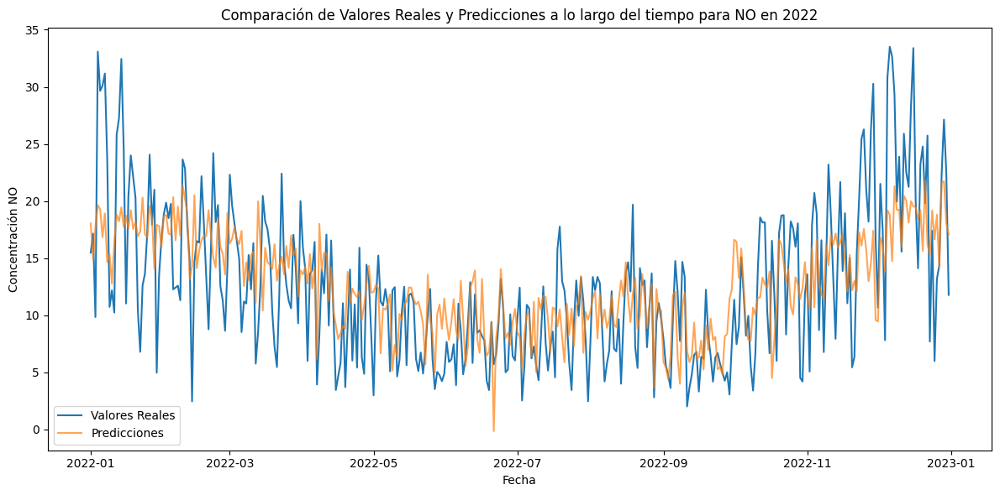

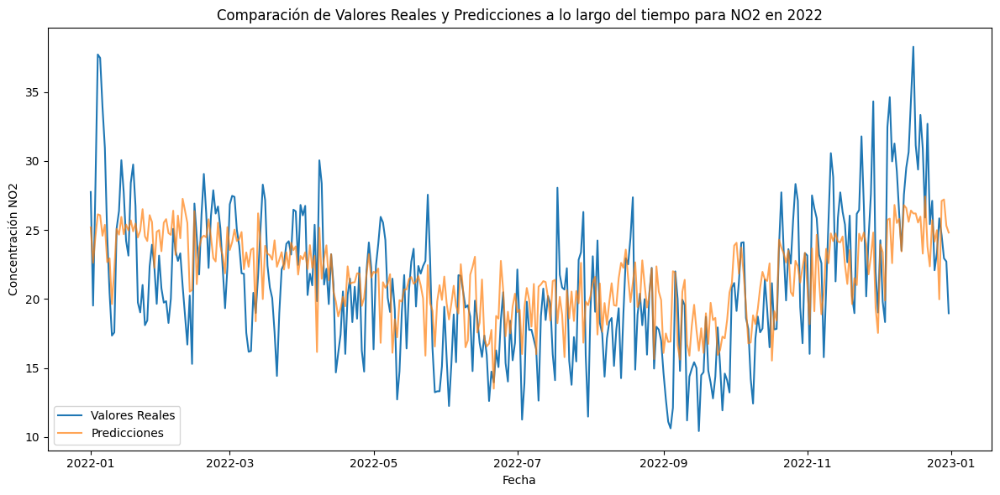

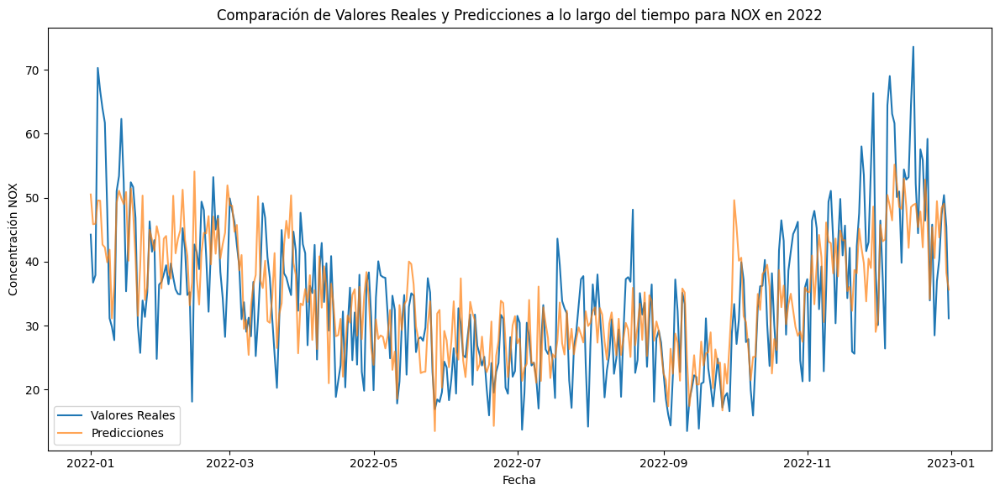

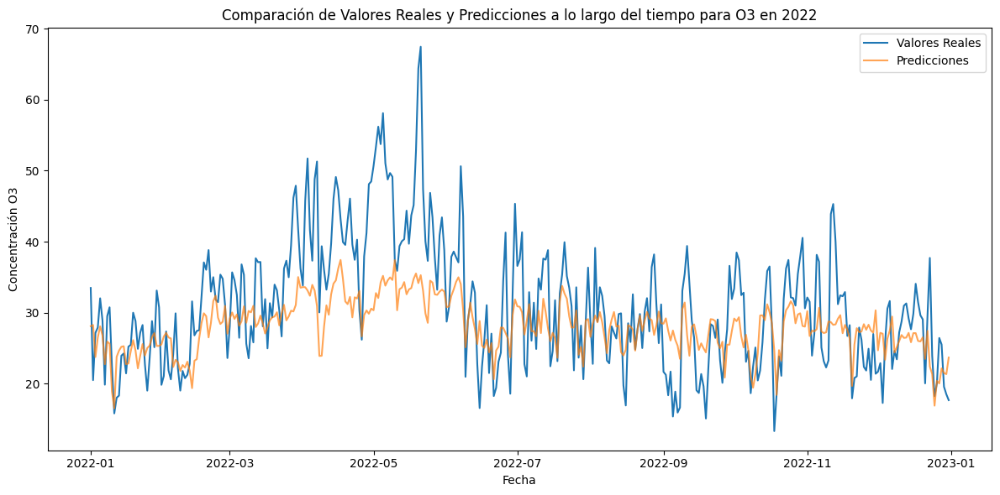

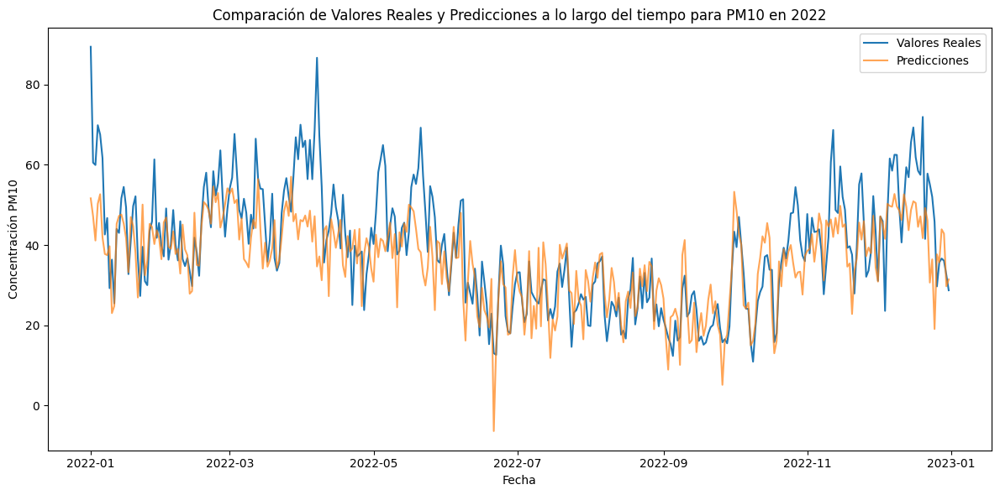

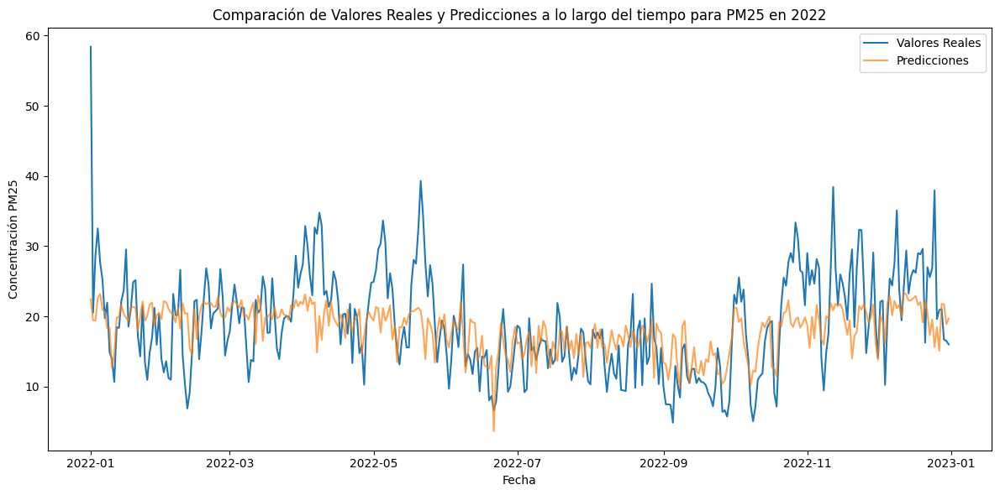

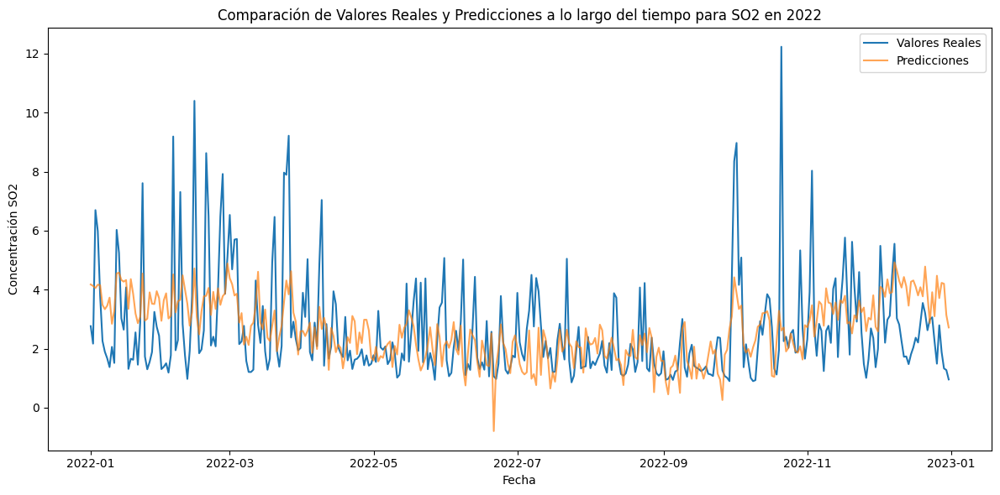

In [40]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.svm import SVR
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Definir el espacio de búsqueda de hiperparámetros
param_grid_svr = {
    'kernel': ['linear', 'poly', 'rbf'],
    'C': [0.1, 1, 10, 100],
    'epsilon': [0.01, 0.1, 0.2, 0.5]
}

# Aplicar GridSearchCV para cada variable objetivo
for target in target_variables:
    y_train = merged_data_train[target]
    y_test = merged_data_test[target]

    # Inicializar el modelo SVR
    svr_model = SVR()

    # Configurar GridSearchCV
    grid_search_svr = GridSearchCV(estimator=svr_model, param_grid=param_grid_svr, scoring='neg_mean_squared_error', cv=3, verbose=2)

    # Realizar la búsqueda de hiperparámetros
    grid_search_svr.fit(X_train, y_train)

    # Obtener los mejores hiperparámetros
    best_params_svr = grid_search_svr.best_params_
    print(f'Mejores hiperparámetros para {target} con SVR: {best_params_svr}')

    # Entrenar el modelo con los mejores hiperparámetros
    best_model_svr = grid_search_svr.best_estimator_
    y_pred_svr = best_model_svr.predict(X_test)
    predictions[target] = (merged_data_test['fecha'], y_test, y_pred_svr)

    # Calcular el RMSE
    rmse_svr = mean_squared_error(y_test, y_pred_svr, squared=False)
    print(f'{target} RMSE con SVR: {rmse_svr}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred_svr = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred_svr
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()


Fitting 3 folds for each of 48 candidates, totalling 144 fits
[CV] END .................C=0.1, epsilon=0.01, kernel=linear; total time=   7.4s
[CV] END .................C=0.1, epsilon=0.01, kernel=linear; total time=   5.5s
[CV] END .................C=0.1, epsilon=0.01, kernel=linear; total time=   9.2s
[CV] END ...................C=0.1, epsilon=0.01, kernel=poly; total time=   0.3s
[CV] END ...................C=0.1, epsilon=0.01, kernel=poly; total time=   0.3s
[CV] END ...................C=0.1, epsilon=0.01, kernel=poly; total time=   0.3s
[CV] END ....................C=0.1, epsilon=0.01, kernel=rbf; total time=   0.4s
[CV] END ....................C=0.1, epsilon=0.01, kernel=rbf; total time=   0.4s
[CV] END ....................C=0.1, epsilon=0.01, kernel=rbf; total time=   0.4s
[CV] END ..................C=0.1, epsilon=0.1, kernel=linear; total time=   6.3s
[CV] END ..................C=0.1, epsilon=0.1, kernel=linear; total time=   3.6s
[CV] END ..................C=0.1, epsilon=0.1, 

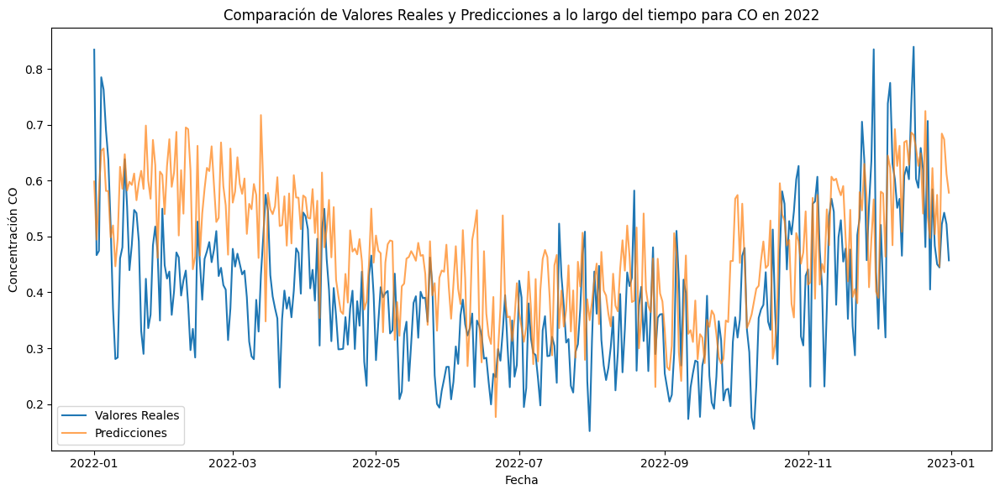

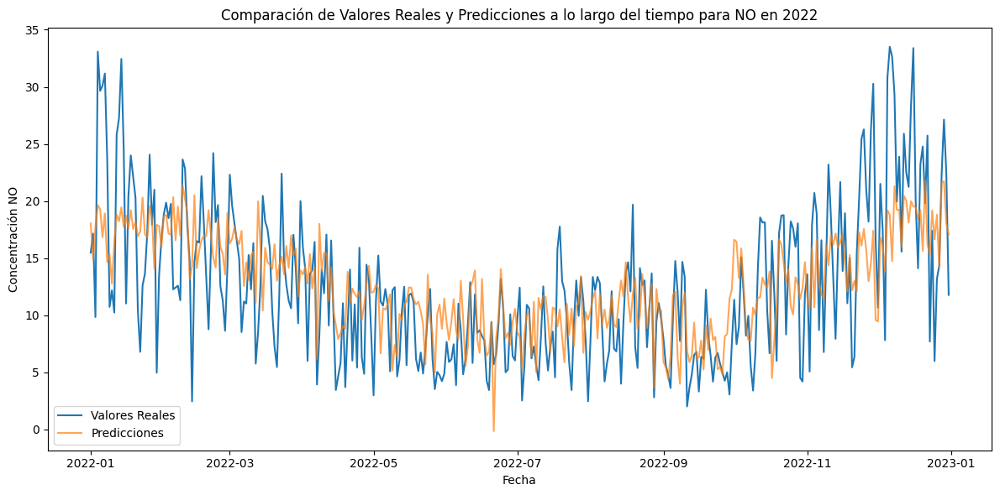

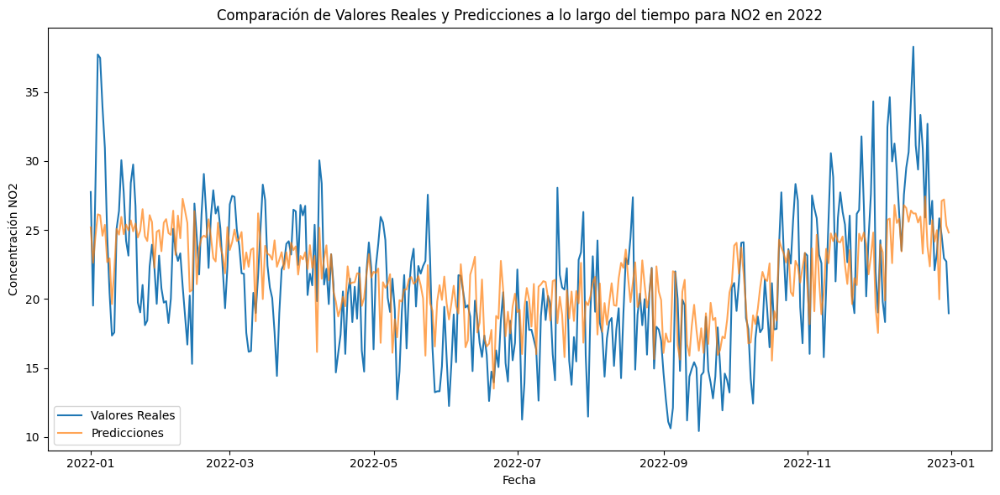

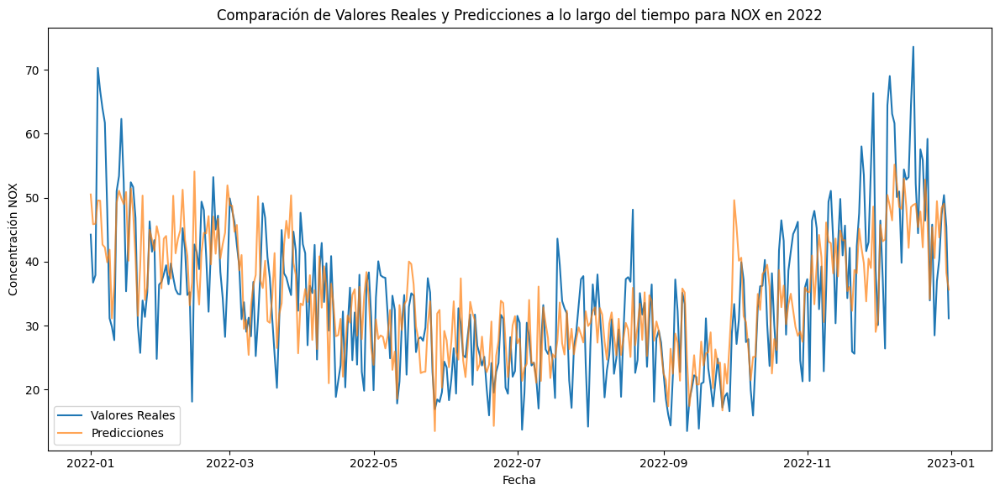

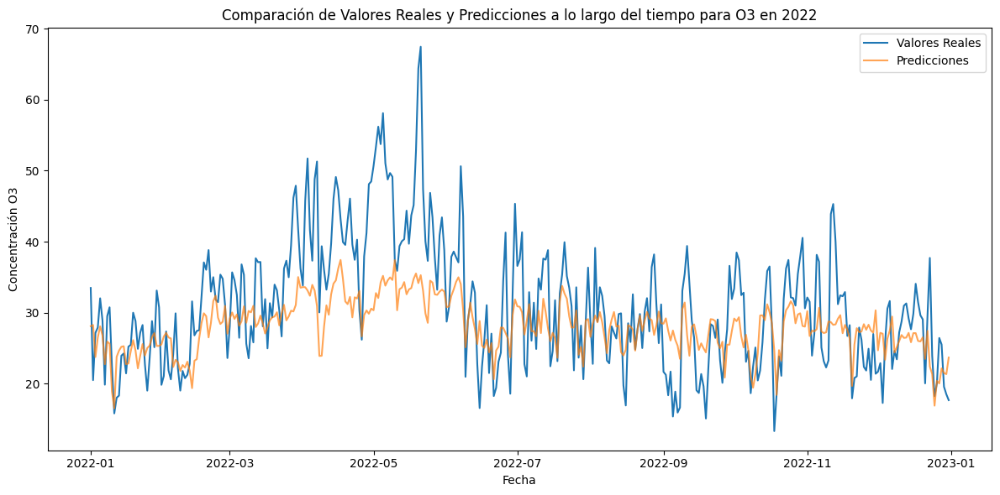

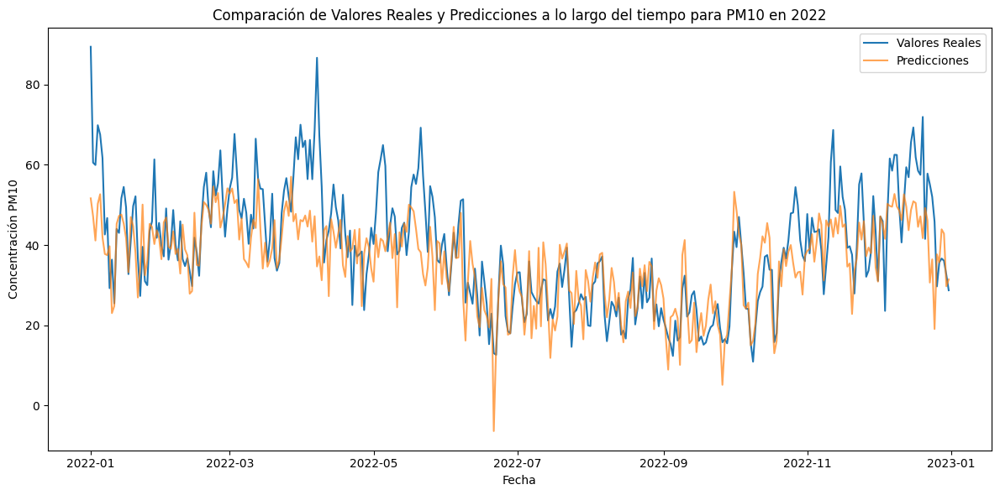

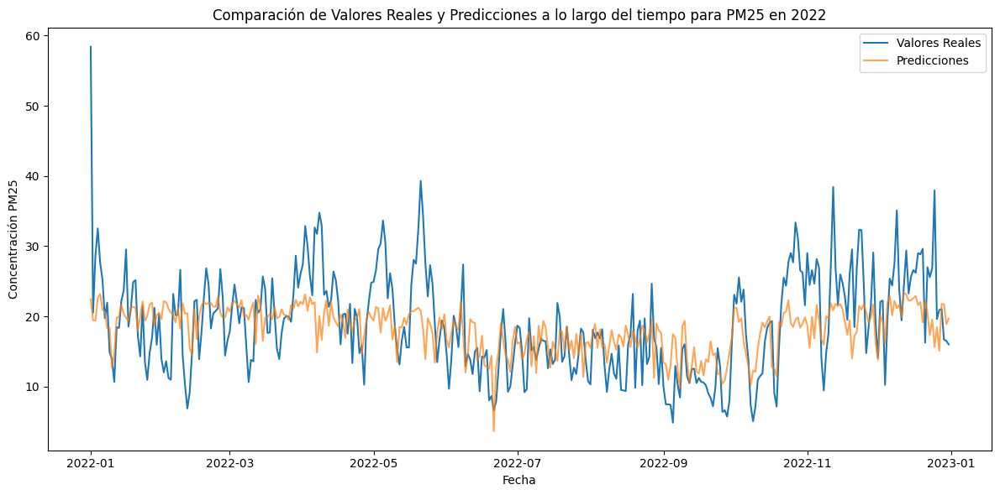

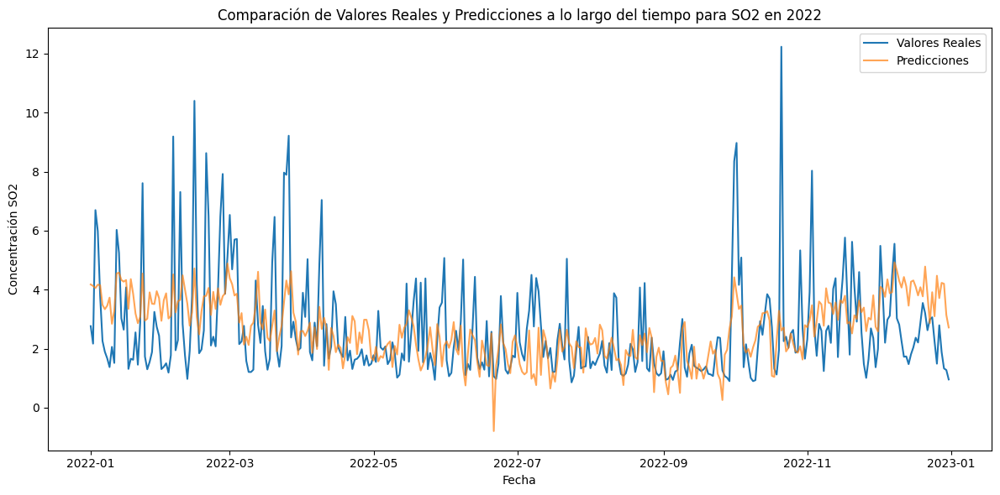

In [41]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.svm import SVR
import matplotlib.pyplot as plt
from meteostat import Point, Daily
from datetime import datetime

# Cargar el archivo CSV con el delimitador adecuado
data_2023 = pd.read_csv('/content/rama_2023_05.csv', encoding='latin1', delimiter=',')

# Definir el punto geográfico para la CDMX
location = Point(19.432608, -99.133209)

# Definir el rango de fechas
start = datetime(2015, 1, 1)
end = datetime(2021, 12, 31)
test_start = datetime(2022, 1, 1)
test_end = datetime(2022, 12, 31)

# Obtener los datos diarios
weather_data_train = Daily(location, start, end)
weather_data_train = weather_data_train.fetch()
weather_data_test = Daily(location, test_start, test_end)
weather_data_test = weather_data_test.fetch()

# Asegurarse de que la columna de fecha en data_2023 esté en formato datetime
data_2023['fecha'] = pd.to_datetime(data_2023['fecha'])

# Filtrar los datos para el entrenamiento (2015-2021) y prueba (2022)
data_train = data_2023[(data_2023['fecha'].dt.year >= 2015) & (data_2023['fecha'].dt.year <= 2021)]
data_test = data_2023[data_2023['fecha'].dt.year == 2022]

# Ordenar los datos por fecha
data_train = data_train.sort_values(by='fecha')
data_test = data_test.sort_values(by='fecha')

# Unir los datos por la columna de fecha
merged_data_train = pd.merge(data_train, weather_data_train, left_on='fecha', right_on='time')
merged_data_test = pd.merge(data_test, weather_data_test, left_on='fecha', right_on='time')

# Renombrar las columnas para mejor comprensión
column_rename_map = {
    'tavg': 'average_temperature',
    'tmin': 'minimum_temperature',
    'tmax': 'maximum_temperature',
    'prcp': 'precipitation',
    'wdir': 'wind_direction',
    'wspd': 'wind_speed',
    'pres': 'pressure'
}
merged_data_train = merged_data_train.rename(columns=column_rename_map)
merged_data_test = merged_data_test.rename(columns=column_rename_map)

# Manejar valores faltantes (puedes ajustar esto según tus necesidades)
merged_data_train = merged_data_train.fillna(method='ffill').fillna(method='bfill')
merged_data_test = merged_data_test.fillna(method='ffill').fillna(method='bfill')

# Seleccionar características (X)
X_train = merged_data_train[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                             'precipitation', 'wind_direction', 'wind_speed', 'pressure']]
X_test = merged_data_test[['average_temperature', 'minimum_temperature', 'maximum_temperature',
                           'precipitation', 'wind_direction', 'wind_speed', 'pressure']]

# Variables objetivo
target_variables = ['CO', 'NO', 'NO2', 'NOX', 'O3', 'PM10', 'PM25', 'SO2']

# Diccionario para almacenar los resultados de las predicciones
predictions = {}

# Definir el espacio de búsqueda de hiperparámetros
param_grid_svr = {
    'kernel': ['linear', 'poly', 'rbf'],
    'C': [0.1, 1, 10, 100],
    'epsilon': [0.01, 0.1, 0.2, 0.5]
}

# Aplicar GridSearchCV para cada variable objetivo
for target in target_variables:
    y_train = merged_data_train[target]
    y_test = merged_data_test[target]

    # Inicializar el modelo SVR
    svr_model = SVR()

    # Configurar GridSearchCV
    grid_search_svr = GridSearchCV(estimator=svr_model, param_grid=param_grid_svr, scoring='neg_mean_squared_error', cv=3, verbose=2)

    # Realizar la búsqueda de hiperparámetros
    grid_search_svr.fit(X_train, y_train)

    # Obtener los mejores hiperparámetros
    best_params_svr = grid_search_svr.best_params_
    print(f'Mejores hiperparámetros para {target} con SVR: {best_params_svr}')

    # Entrenar el modelo con los mejores hiperparámetros
    best_model_svr = grid_search_svr.best_estimator_
    y_pred_svr = best_model_svr.predict(X_test)
    predictions[target] = (merged_data_test['fecha'], y_test, y_pred_svr)

    # Calcular el RMSE
    rmse_svr = mean_squared_error(y_test, y_pred_svr, squared=False)
    print(f'{target} RMSE con SVR: {rmse_svr}')

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred_svr = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred_svr
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()


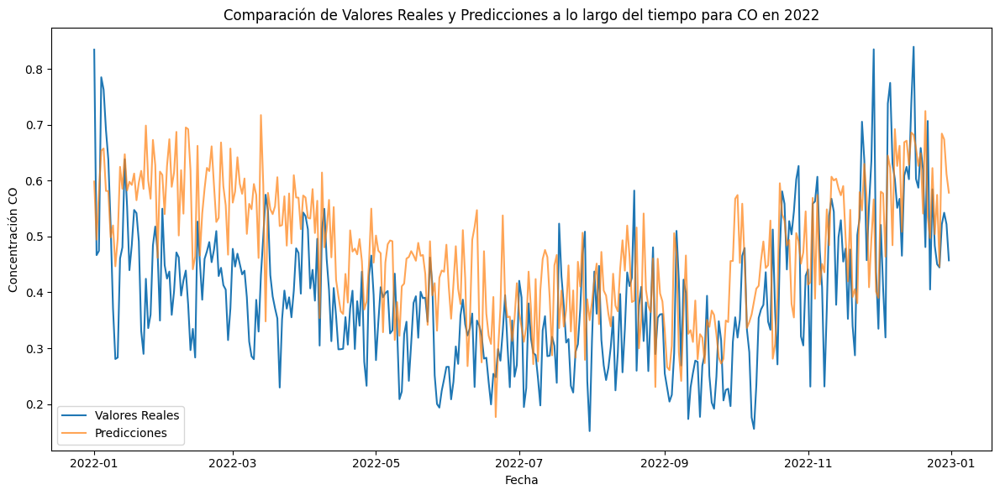

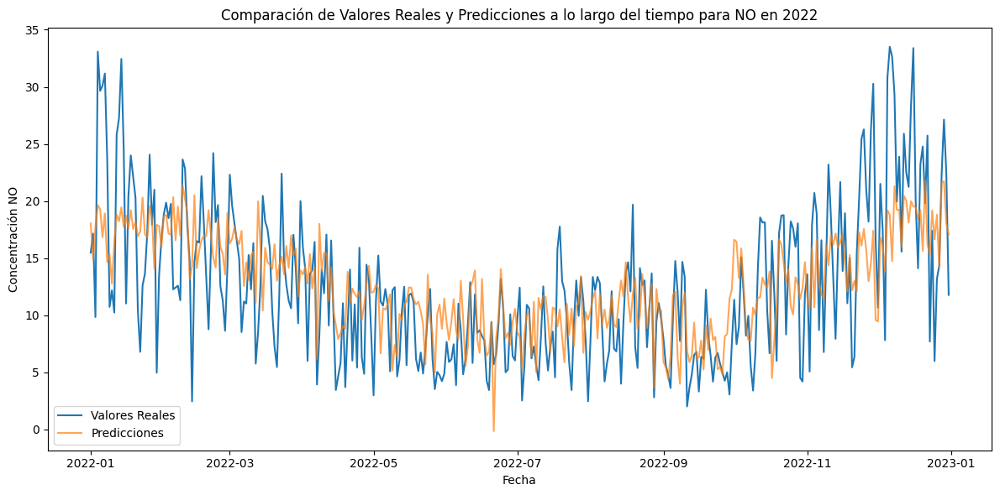

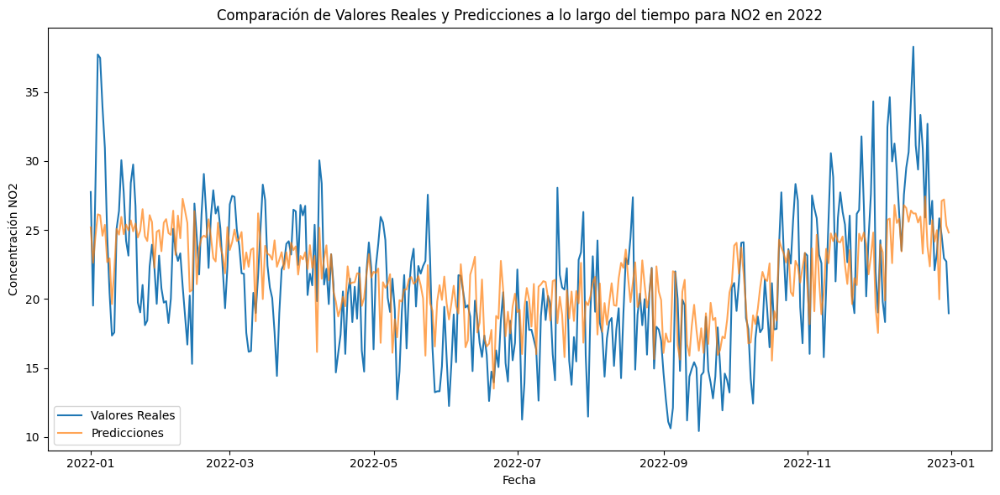

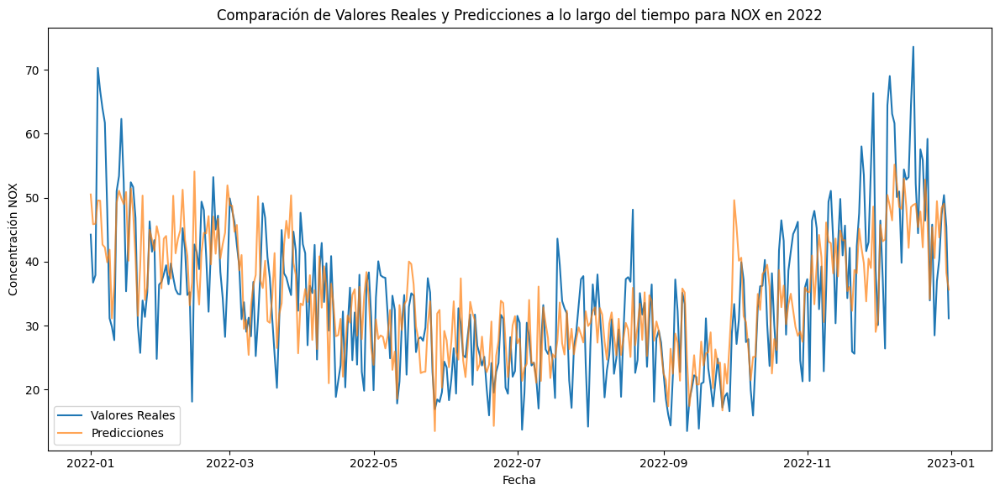

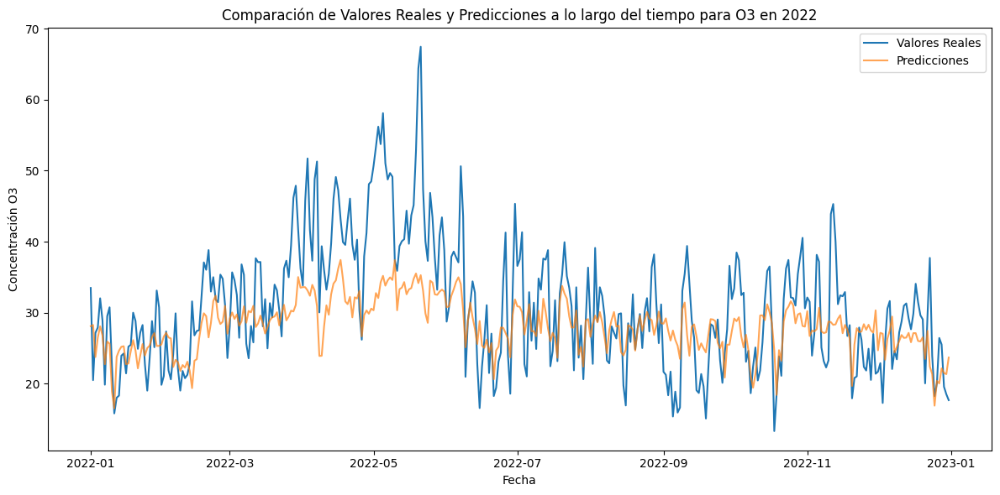

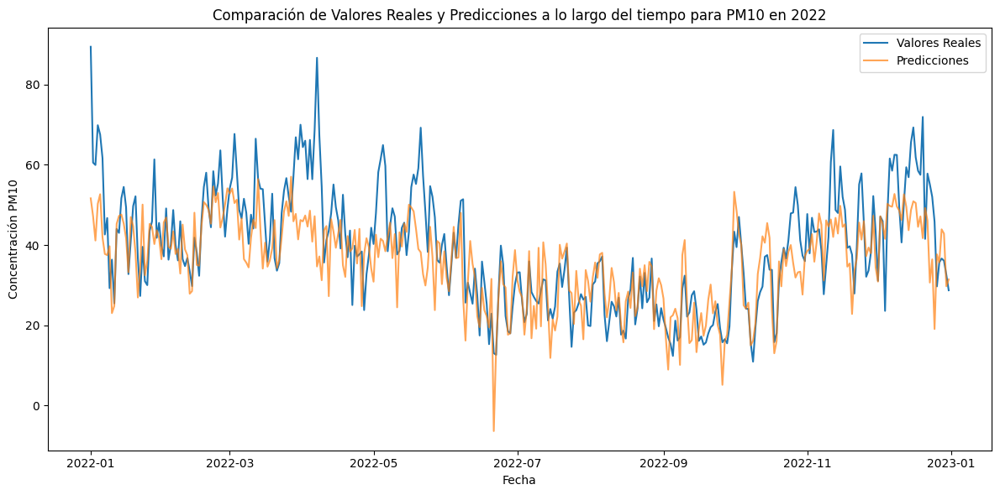

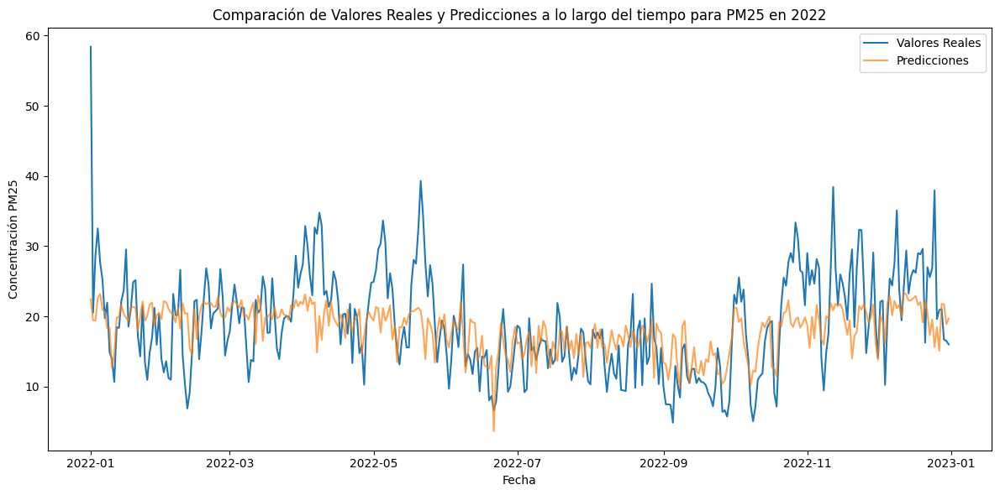

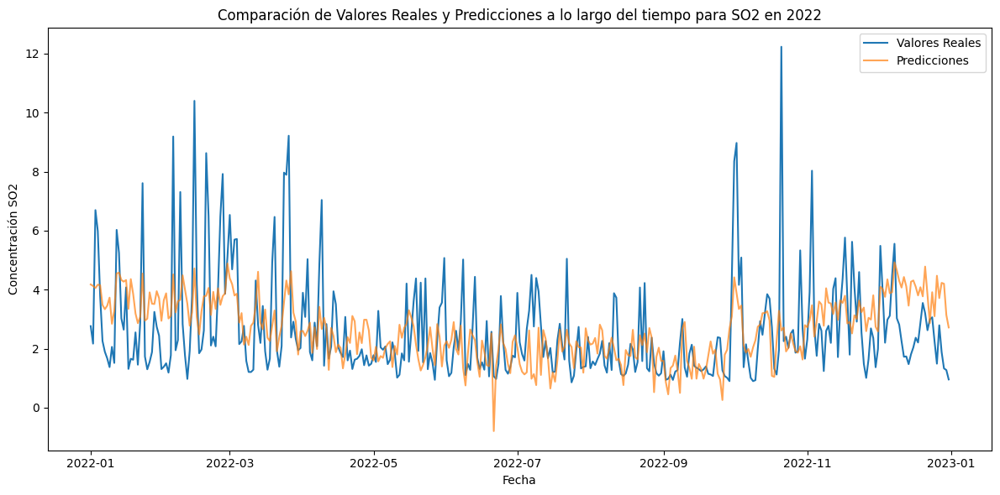

In [42]:
import matplotlib.pyplot as plt

# Crear y graficar los DataFrames de comparación para cada variable objetivo
for target in target_variables:
    dates, y_test, y_pred_svr = predictions[target]

    comparison_df = pd.DataFrame({
        'Fecha': dates,
        'Actual': y_test.values,
        'Predicted': y_pred_svr
    }).sort_values('Fecha')

    # Graficar los valores reales y predichos
    plt.figure(figsize=(12, 6))
    plt.plot(comparison_df['Fecha'], comparison_df['Actual'], label='Valores Reales')
    plt.plot(comparison_df['Fecha'], comparison_df['Predicted'], label='Predicciones', alpha=0.7)
    plt.xlabel('Fecha')
    plt.ylabel(f'Concentración {target}')
    plt.title(f'Comparación de Valores Reales y Predicciones a lo largo del tiempo para {target} en 2022')
    plt.legend()
    plt.tight_layout()
    plt.show()
